# 💸 Sueldos IT - SysArmy - Argentina 
<img src="https://resizer.iproimg.com/unsafe/880x/filters:format(webp)/https://assets.iprofesional.com/assets/jpg/2022/04/534548.jpg">

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/argentina-salary-survey-sysarmy/2023.2_Sysarmy_Encuesta de remuneracin salarial Argentina.csv
/kaggle/input/argentina-salary-survey-sysarmy/2023.1_Sysarmy_Encuesta de remuneracin salarial Argentina.csv


In [2]:
pip install mplcyberpunk

Note: you may need to restart the kernel to use updated packages.


In [3]:
import matplotlib.pyplot as plt
import seaborn as sns
import mplcyberpunk
from sklearn.preprocessing import LabelEncoder, MultiLabelBinarizer
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.linear_model import LinearRegression, SGDRegressor
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor

import re
import random

pd.options.display.max_columns = None
plt.style.use("cyberpunk")

## Configuracion para la reproducibilidad

In [4]:
seed_value = 42
os.environ['PYTHONHASHSEED'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

# Hechando un vistazo al set de datos

In [5]:
df = pd.read_csv("/kaggle/input/argentina-salary-survey-sysarmy/2023.2_Sysarmy_Encuesta de remuneracin salarial Argentina.csv")
df.head()

,estoy_trabajando_en,donde_estas_trabajando,dedicacion,tipo_de_contrato,ultimo_salario_mensual_o_retiro_bruto_en_tu_moneda_local,ultimo_salario_mensual_o_retiro_neto_en_tu_moneda_local,pagos_en_dolares,si_tu_sueldo_esta_dolarizado_cual_fue_el_ultimo_valor_del_dolar_que_tomaron,recibis_algun_tipo_de_bono,a_que_esta_atado_el_bono,tuviste_actualizaciones_de_tus_ingresos_laborales_durante_2023,de_que_fue_el_ajuste_total_acumulado,en_que_mes_fue_el_ultimo_ajuste,como_consideras_que_estan_tus_ingresos_laborales_comparados_con_el_semestre_anterior,contas_con_beneficios_adicionales,que_tan_conforme_estas_con_tus_ingresos_laborales,estas_buscando_trabajo,trabajo_de,anos_de_experiencia,antiguedad_en_la_empresa_actual,tiempo_en_el_puesto_actual,cuantas_personas_a_cargo_tenes,plataformas_que_utilizas_en_tu_puesto_actual,lenguajes_de_programacion_o_tecnologias_que_utilices_en_tu_puesto_actual,frameworksherramientas_y_librerias_que_utilices_en_tu_puesto_actual,bases_de_datos,qa_testing,cantidad_de_personas_en_tu_organizacion,modalidad_de_trabajo,si_trabajas_bajo_un_esquema_hibrido_cuantos_dias_a_la_semana_vas_a_la_oficina,la_recomendas_como_un_buen_lugar_para_trabajar,que_tanto_estas_usando_copilotchatgpt_u_otras_herramientas_de_ia_para_tu_trabajo,salir_o_seguir_contestando,maximo_nivel_de_estudios,estado,carrera,institucion_educativa,salir_o_seguir_contestando_sobre_las_guardias,tenes_guardias,cuanto_cobras_por_guardia,aclara_el_numero_que_ingresaste_en_el_campo_anterior,salir_o_seguir_contestando_sobre_estudios,tengo_edad,me_identifico_genero,sueldo_dolarizado,seniority,_sal
0,Argentina,Buenos Aires,Full-Time,Contractor,2000000.0,2000000.0,Cobro todo el salario en dólares,497,Menos de un sueldo,Performance individual,No,0.0,No tuve,3,"Abono de Internet, Descuento en gimnasios / Cl...",3,"No, pero escucho ofertas.",Scrum Master,15,2,2,0,Ninguna de las anteriores,Ninguno de los anteriores,Ninguno de los anteriores,Ninguna de las anteriores,Ninguna de las anteriores,De 201 a 500 personas,100% remoto,0,10,4,Terminar encuesta,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40,Hombre Cis,True,Senior,2000000.0
1,Argentina,Río Negro,Full-Time,Contractor,2133000.0,1919000.0,Cobro todo el salario en dólares,NaN,No,No recibo bono,No,0.0,No tuve,2,"Horarios flexibles, Vacaciones flexibles (adic...",3,"No, pero escucho ofertas.",Developer,6,1,1,0,Amazon Web Services,TypeScript,"Angular, Bootstrap",Ninguna de las anteriores,Karma,De 11 a 50 personas,100% remoto,0,6,4,Responder sobre mis estudios,Universitario,Completo,Ingeniería en Sistemas,UNS - Universidad Nacional del Sur,Terminar encuesta,NaN,NaN,NaN,NaN,32,Hombre Cis,True,Senior,2133000.0
2,Argentina,Buenos Aires,Full-Time,Staff (planta permanente),485000.0,404000.0,Cobro parte del salario en dólares,NaN,Menos de un sueldo,Mix de las anteriores,Dos,35.0,Abril,3,Descuento en gimnasios / Clases de gimnasia on...,3,"No, pero escucho ofertas.",Developer,3,1,1,0,"Amazon Web Services, Docker","Go, Java",Ninguno de los anteriores,Amazon DynamoDB,"JUnit, Postman",De 1001 a 2000 personas,100% remoto,0,7,0,Responder sobre guardias,Terciario,Completo,Tecnicatura Universitaria en Sistemas Informát...,UTN - Universidad Tecnológica Nacional,Terminar encuesta,No,0.0,Porcentaje de mi sueldo bruto,Responder sobre mis estudios,25,Hombre Cis,True,Semi-Senior,485000.0
3,Argentina,Ciudad Autónoma de Buenos Aires,Full-Time,Staff (planta permanente),942000.0,577000.0,Cobro parte del salario en dólares,230,3+ sueldos,Performance de la compañía,Tres,35.0,Junio,3,Horarios flexibles,3,"No, pero escucho ofertas.",Technical Support,12,1,1,0,Azure,"PHP, Python, SQL",Ninguno de los anteriores,Microsoft SQL Server,Ninguna de las anteriores,De 11 a 50 personas,100% remoto,0,7,3,Terminar encuesta,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34,Hombre Cis,True,Senior,942000.0
4,Argentina,Ciudad Autónoma de Buenos Aires,Full-Time,Staff (planta permanente),660000.0,380000.0,Mi sueldo está dolarizado (pero cobro en moned...,231,De uno a tres sueldos,Mix d

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5422 entries, 0 to 5421
Data columns (total 47 columns):
 #   Column                                                                                Non-Null Count  Dtype  
---  ------                                                                                --------------  -----  
 0   estoy_trabajando_en                                                                   5422 non-null   object 
 1   donde_estas_trabajando                                                                5422 non-null   object 
 2   dedicacion                                                                            5422 non-null   object 
 3   tipo_de_contrato                                                                      5422 non-null   object 
 4   ultimo_salario_mensual_o_retiro_bruto_en_tu_moneda_local                              5422 non-null   float64
 5   ultimo_salario_mensual_o_retiro_neto_en_tu_moneda_local                            

Con el fin de trabajar de forma mas comoda, sera conveniente renombrar aquellas caracteristicas que tienen nombres muy extensos.

In [7]:
df.rename(columns={"ultimo_salario_mensual_o_retiro_bruto_en_tu_moneda_local": "salario_bruto",
                  "ultimo_salario_mensual_o_retiro_neto_en_tu_moneda_local" : "salario_neto",
                  "si_tu_sueldo_esta_dolarizado_cual_fue_el_ultimo_valor_del_dolar_que_tomaron": "cotizacion_empleada_del_dolar",
                  "recibis_algun_tipo_de_bono": "tipo_de_bono",
                  "tuviste_actualizaciones_de_tus_ingresos_laborales_durante_2023": "actualizacion_de_ingresos",
                  "de_que_fue_el_ajuste_total_acumulado": "ajuste_total_acumulado",
                  "en_que_mes_fue_el_ultimo_ajuste": "mes_del_ultimo_ajuste",
                  "como_consideras_que_estan_tus_ingresos_laborales_comparados_con_el_semestre_anterior": "cuanto_mejoraron_tus_ingresos",
                  "contas_con_beneficios_adicionales": "beneficios_adicionales",
                  "que_tan_conforme_estas_con_tus_ingresos_laborales": "conformidad_con_tus_ingresos",
                  "trabajo_de": "puesto",
                  "antiguedad_en_la_empresa_actual": "antiguedad",
                  "tiempo_en_el_puesto_actual": "tiempo_en_el_puesto",
                  "cuantas_personas_a_cargo_tenes": "personas_a_cargo",
                  "plataformas_que_utilizas_en_tu_puesto_actual": "plataformas",
                  "frameworksherramientas_y_librerias_que_utilices_en_tu_puesto_actual": "frameworks/herramientas/librerias",
                  "si_trabajas_bajo_un_esquema_hibrido_cuantos_dias_a_la_semana_vas_a_la_oficina": "dias_presenciales",
                  "la_recomendas_como_un_buen_lugar_para_trabajar": "recomendas_tu_empresa",
                  "que_tanto_estas_usando_copilotchatgpt_u_otras_herramientas_de_ia_para_tu_trabajo": "uso_de_herramientas_de_ia",
                  "lenguajes_de_programacion_o_tecnologias_que_utilices_en_tu_puesto_actual": "lenguajes_de_programacion/tecnologias",
                  "me_identifico_genero": "genero",
                  }, inplace=True)

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5422 entries, 0 to 5421
Data columns (total 47 columns):
 #   Column                                                Non-Null Count  Dtype  
---  ------                                                --------------  -----  
 0   estoy_trabajando_en                                   5422 non-null   object 
 1   donde_estas_trabajando                                5422 non-null   object 
 2   dedicacion                                            5422 non-null   object 
 3   tipo_de_contrato                                      5422 non-null   object 
 4   salario_bruto                                         5422 non-null   float64
 5   salario_neto                                          5212 non-null   float64
 6   pagos_en_dolares                                      1783 non-null   object 
 7   cotizacion_empleada_del_dolar                         1117 non-null   object 
 8   tipo_de_bono                                          5422

## Definiendo targets

Al parecer tenemos dos caracteristicas iguales, "_sal" y "salario_bruto", veamos si es cierto esto.

In [8]:
(df["_sal"] == df["salario_bruto"]).all()

True

Verificamos que son iguales, por lo tanto al ser "salario_bruto" igual a "_sal" debemos eliminar esta ultima por que "salario_bruto" sera uno de nuestros targets.

In [9]:
df.drop(["_sal"], axis=1, inplace=True)
targets = ["salario_bruto", "lenguajes_de_programacion/tecnologias"]
df[targets].isna().sum()

salario_bruto                            0
lenguajes_de_programacion/tecnologias    2
dtype: int64

Registros con targets faltantes no nos son utiles, los eliminaremos.

In [10]:
df.drop(df[df[targets[1]].isna()].index, axis=0, inplace=True)

# Separando en set de prueba y entrenamiento

In [11]:
train, test, y_train, y_test = train_test_split(df.drop(targets, axis=1), df[targets], test_size=0.30, random_state=seed_value)
train.shape, test.shape

((3794, 44), (1626, 44))

# Datos faltantes

In [12]:
nans = train.isna().sum().sort_values(ascending=False)
nans = nans[nans > 0]
nans = pd.DataFrame(data={"Caracteristica":nans.index, "Cantidad de datos faltantes":nans.values, "Porcentaje de representancion en el dataset":nans.values*100/len(train)})
nans

,Caracteristica,Cantidad de datos faltantes,Porcentaje de representancion en el dataset
0,cotizacion_empleada_del_dolar,3034,79.968371
1,salir_o_seguir_contestando_sobre_estudios,2644,69.688983
2,aclara_el_numero_que_ingresaste_en_el_campo_an...,2644,69.688983
3,cuanto_cobras_por_guardia,2644,69.688983
4,tenes_guardias,2644,69.688983
5,pagos_en_dolares,2581,68.028466
6,institucion_educativa,2460,64.839220
7,carrera,2152,56.721139
8,salir_o_seguir_contestando_sobre_las_guardias,2100,55.350554
9,maximo_nivel_de_estudios,2100,55.350554


A priori podemos descartar todas las caracteristicas que tengan mas del 20% de registros faltantes, ya que seria inutil rellenar tantos registros faltantes. Esto sesgaria las predicciones de nuestros estimadores.

In [13]:
train = train.drop(nans[nans["Porcentaje de representancion en el dataset"] > 20]["Caracteristica"].tolist(), axis=1)
test = test.drop(nans[nans["Porcentaje de representancion en el dataset"] > 20]["Caracteristica"].tolist(), axis=1)
train.shape, train.shape

((3794, 33), (3794, 33))

In [14]:
nans = train.isna().sum().sort_values(ascending=False)
nans = nans[nans > 0]
nans = pd.DataFrame(data={"Caracteristica":nans.index, "Cantidad de datos faltantes":nans.values, "Porcentaje de representancion en el dataset":nans.values*100/len(train)})
nans

,Caracteristica,Cantidad de datos faltantes,Porcentaje de representancion en el dataset
0,salario_neto,150,3.953611
1,qa_testing,3,0.079072
2,bases_de_datos,1,0.026357


Vemos que aun tenemos algunas caracteristicas con datos faltantes, antes de tratarlos debemos analizar los outliers.

# Datos duplicados

In [15]:
train.duplicated().sum()

0

No hay datos duplicados.

# Detectando outliers

In [16]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3794 entries, 579 to 860
Data columns (total 33 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   estoy_trabajando_en                      3794 non-null   object 
 1   donde_estas_trabajando                   3794 non-null   object 
 2   dedicacion                               3794 non-null   object 
 3   tipo_de_contrato                         3794 non-null   object 
 4   salario_neto                             3644 non-null   float64
 5   tipo_de_bono                             3794 non-null   object 
 6   a_que_esta_atado_el_bono                 3794 non-null   object 
 7   actualizacion_de_ingresos                3794 non-null   object 
 8   ajuste_total_acumulado                   3794 non-null   float64
 9   mes_del_ultimo_ajuste                    3794 non-null   object 
 10  cuanto_mejoraron_tus_ingresos            3794 non-nu

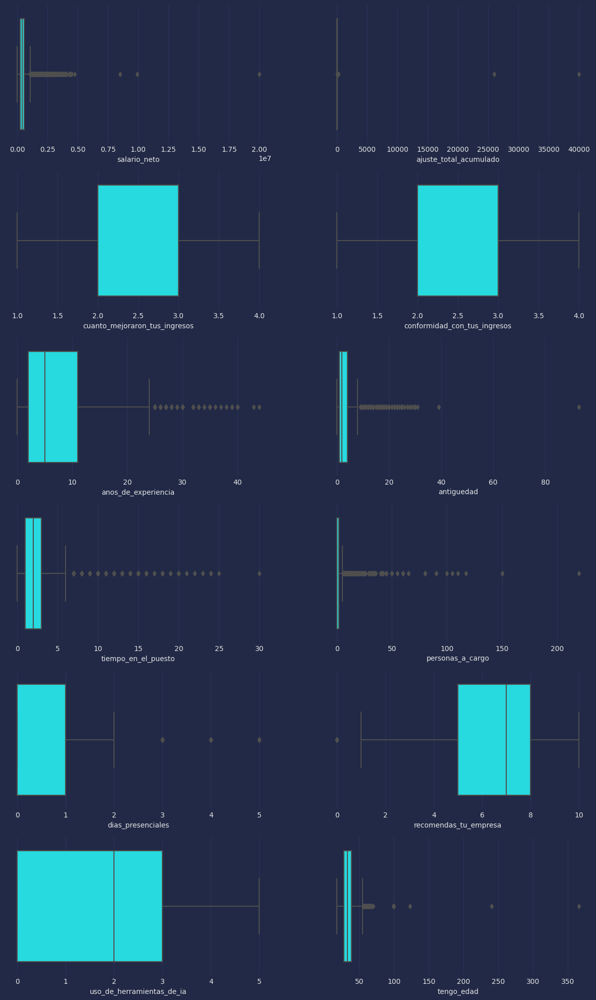

In [17]:
col_numericas = train.select_dtypes(["float64", "int64"]).columns.tolist()

fig, axs = plt.subplots(6, 2, figsize=(15, 25))
for i, col in enumerate(col_numericas):
    plt.subplot(6, 2, i+1)
    sns.boxplot(data=train, x=col)

Observaciones importantes:
+ No todas las variables tienen outliers, por lo tanto solo atacaremos aquellas que si.
+ Hay trabajores que registraron edades mayores a 100 años 👀.
+ Hay al menos una persona que registro que tiene mas de 80 años de antiguedad en la empresa 👀.
+ Realmente hay personas que tengan mas de 200 personas a cargo? No parece tan real 👀.

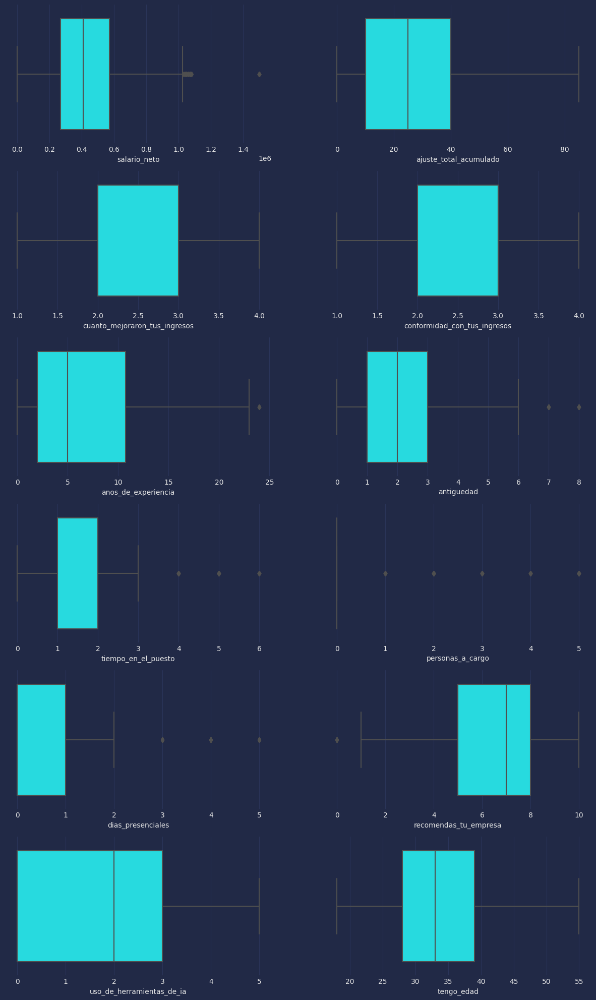

In [18]:
def detect_outliers(train, columns, tipo="leve", test=None):
    train_ = train.copy()
    test_ = test.copy()
    for col in columns:
        if tipo == "extremo":
            k = 3
        else:
            k = 1.5
        describe = train_.describe()
        Q1 = train_[col].quantile(0.25)
        Q3 = train_[col].quantile(0.75)
        IQR = Q3 - Q1 #Rango intercuartilico
        for dataset in [train_, test_]:
            interval = ((dataset[col] < Q1 - k*IQR) | (dataset[col] > Q3 + k*IQR))
            dataset.loc[interval, col] = dataset.groupby(["conformidad_con_tus_ingresos", "seniority", "sueldo_dolarizado"])[col].transform('median')[interval] #describe[col]["50%"]
    return train_, test_, describe

col_outliers = ['salario_neto', 'ajuste_total_acumulado', 'anos_de_experiencia', 'antiguedad', 'tiempo_en_el_puesto', 'personas_a_cargo', 'tengo_edad']

train, test, describe = detect_outliers(train, col_outliers, tipo="leve", test=test)

fig, axs = plt.subplots(6, 2, figsize=(15, 25))
for i, col in enumerate(col_numericas):
    plt.subplot(6, 2, i+1)
    sns.boxplot(data=train, x=col)

Despues de este ajuste podemos ver que estas caracteristicas parecen mas coherentes.

# Rellenando datos faltantes

In [19]:
nans = train.isna().sum().sort_values(ascending=False)
nans = nans[nans > 0]
nans = pd.DataFrame(data={"Caracteristica":nans.index, "Cantidad de datos faltantes":nans.values, "Porcentaje de representancion en el dataset":nans.values*100/len(train)})
nans

,Caracteristica,Cantidad de datos faltantes,Porcentaje de representancion en el dataset
0,salario_neto,150,3.953611
1,qa_testing,3,0.079072
2,bases_de_datos,1,0.026357


## Estrategias

> ***Relleno de datos numericos continuos***
> 
> Una buena forma de rellenar estos tipos de datos es utilizar la **media** de los datos restantes.

> ***Rellenando datos numericos discretos***
> 
> Una buena forma de rellenar estos tipos de datos es utilizar la **media redondeada** de los datos restantes.

> ***Rellenando datos binarios***
> 
> Para el relleno de datos faltantes de caracter binario una buena estrategia consiste en asignarles la **moda** de la caracteristica.

> ***Rellenando datos categoricos***
> 
> Para el relleno de datos faltantes de caracter categoricos una buena estrategia consiste en asignarles la **moda** de la caracteristica.

## Generalizando el relleno de datos faltantes

In [20]:
def NaN_imputer(df, reference=None):
    df_ = df.copy()
    nan_col = df_.columns[df_.isna().any()]
    col_cat = df_[nan_col].select_dtypes(["object"]).columns
    col_disc = df_[nan_col].select_dtypes([int]).columns
    col_cont = df_[nan_col].select_dtypes([float]).columns
    col_bool = df_[nan_col].select_dtypes([bool]).columns
    
    if reference is None:
        reference = df.copy()
        
    for col in col_cat:
        df_[col] = df_[col].fillna(reference[col].mode()[0])
    df_[col_disc] = df_[col_disc].fillna(np.round(reference[col_disc].mean()))
    df_[col_cont] = df_[col_cont].fillna(reference[col_cont].mean())
    df_[col_bool] = df_[col_bool].fillna(reference[col_bool].mode())
    
    return df_

train = NaN_imputer(train)
test = NaN_imputer(test, train)

Finalmente podemos ver que ya no tenemos datos faltantes.

In [21]:
nans_ = train.isna().sum().sort_values(ascending=False)
nans_ = pd.DataFrame(data={"Caracteristica":nans_.index, "Cantidad de datos faltantes":nans_.values, "Porcentaje de representancion en el dataset":nans_.values*100/len(train)})
nans_[nans_["Caracteristica"].isin(nans["Caracteristica"])]

,Caracteristica,Cantidad de datos faltantes,Porcentaje de representancion en el dataset
11,qa_testing,0,0.0
12,bases_de_datos,0,0.0
29,salario_neto,0,0.0


# Caracteristicas redundantes

In [22]:
columns = train.columns

value_counts = pd.DataFrame(index=columns.values, columns=["Cantidad de datos diferentes"])
for col in columns:
    value_counts.loc[col, "Cantidad de datos diferentes"] = len(train[col].value_counts())
value_counts.sort_values(by="Cantidad de datos diferentes")

,Cantidad de datos diferentes
estoy_trabajando_en,1
dedicacion,2
sueldo_dolarizado,2
salir_o_seguir_contestando,3
modalidad_de_trabajo,3
estas_buscando_trabajo,3
seniority,3
cuanto_mejoraron_tus_ingresos,4
conformidad_con_tus_ingresos,4
actualizacion_de_ingresos,5


In [23]:
train["estoy_trabajando_en"].value_counts()

estoy_trabajando_en
Argentina    3794
Name: count, dtype: int64

La caracteristica "estoy_trabajando_en" tiene un unico valor, esto la convierte en una caracteristica redundante ya que no nos brinda ninguna informacion relevante.

In [24]:
train["salir_o_seguir_contestando"].value_counts()

salir_o_seguir_contestando
Terminar encuesta               2026
Responder sobre mis estudios    1224
Responder sobre guardias         544
Name: count, dtype: int64

Tambien encontramos que hay columnas que sirven para analizar el desempeño de la encuesta en si, y para el analisis que vamos a realizar nos resultan irrelevantes

In [25]:
train["a_que_esta_atado_el_bono"].value_counts()

a_que_esta_atado_el_bono
No recibo bono                          2106
Mix de las anteriores                    609
Performance individual                   452
Performance de la compañía               356
Performance grupal                        89
                                        ... 
comisiones                                 1
por convenio                               1
bono de cumpleaño y el del sindicato       1
Random por decisión de los dueños          1
Permanencia, performance                   1
Name: count, Length: 140, dtype: int64

Esta caracteristica parece que mas que una certeza fuera lo que perciben los trabajadores acerca del motivo de las bonificaciones percibidas, la caracteristica verdaderamente importante e interesante es "tipo_de_bono" que nos dice exactamente si los trabajadores perciben, o no, un bono y el monto de dicha bonificacion. Ademas podemos ver que no podemos extraer informacion importante de esta caracteristica y tambien podemos ver que esta caracteristica tiene multiples valores categoricos diferentes, se dificulta realizar un pre-procesamiento sobre caracteristicas de este tipo.

In [26]:
train.drop(["estoy_trabajando_en", "salir_o_seguir_contestando", "a_que_esta_atado_el_bono"], axis=1, inplace=True)
test.drop(["estoy_trabajando_en", "salir_o_seguir_contestando", "a_que_esta_atado_el_bono"], axis=1, inplace=True)

# Visualizacion de datos
## Procedencia de los encuestados

In [27]:
def my_countplot(train, col, figsize=(15, 15)):
    plt.figure(figsize=figsize, dpi=700)
    ax = sns.countplot(data=train, y=col, order=train[col].value_counts().sort_values(ascending=False).index);
    abs_values = train[col].value_counts(ascending=False)
    rel_values = train[col].value_counts(ascending=False).values*100/len(train)
    lbls = [f'{p[0]} ({p[1]:.2f}%)' for p in zip(abs_values, rel_values)]
    ax.bar_label(container=ax.containers[0], labels=lbls);
    return
    
my_countplot(train, "donde_estas_trabajando", figsize=(15, 10))
plt.xlabel("Cantidad de encuestados")
plt.ylabel("Provincia de Argentina");

Como podemos observar la mayoria de encuestados son de CABA, otro gran numero de encuestados pertenecen a la provincia de Buenos Aires y Cordoba. Sera que la mayor parte de trabajadores IT residen en su mayoria en CABA? o simplemente la encuesta tuvo mayor difusion en estas areas?

## Tipo de jornada laboral de los encuestados

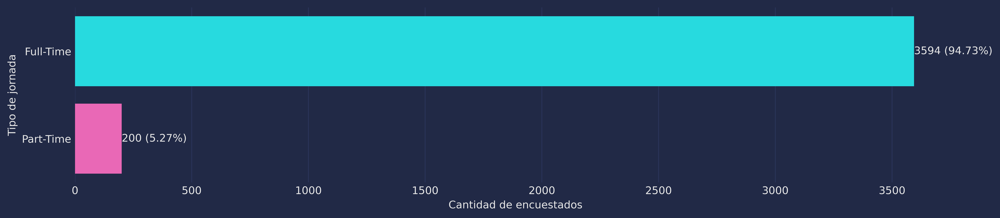

In [28]:
my_countplot(train, "dedicacion", figsize=(15, 3))
plt.ylabel("Tipo de jornada")
plt.xlabel("Cantidad de encuestados");

En su mayoria el tipo de jornada empleado en Argentina es el de Full-Time para el sector IT.

## Existen sueldos dolarizados en Argentina?

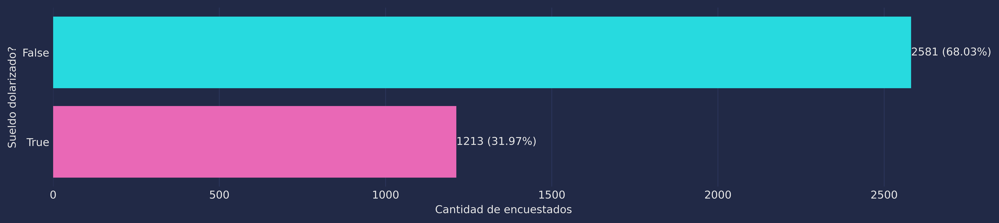

In [29]:
my_countplot(train, "sueldo_dolarizado", figsize=(15, 3))
plt.ylabel("Sueldo dolarizado?")
plt.xlabel("Cantidad de encuestados");

Claro que si existen, pero no es el tipo de cambio preferido para pagar los sueldos en Argentina por parte de las empresas, pero representan casi un tercio del dataset.

## Expertise de los encuestados

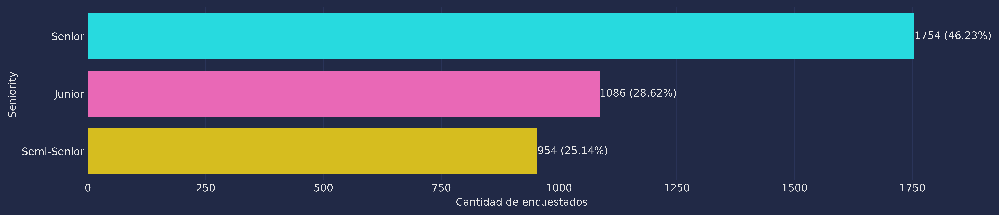

In [30]:
my_countplot(train, "seniority", figsize=(15, 3))
plt.xlabel("Cantidad de encuestados")
plt.ylabel("Seniority");

La mayoria de trabajadores considera que tiene un expertise de Senior, esto indica el nivel de programadores que tenemos en Argentina? Si fuera asi podemos especular que hay un buen nivel.

## Modalidad de trabajo

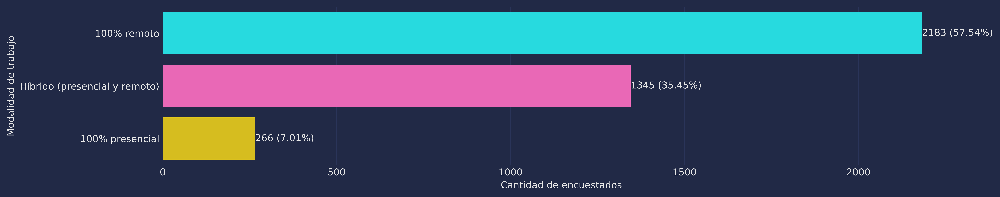

In [31]:
my_countplot(train, "modalidad_de_trabajo", figsize=(15, 3))
plt.xlabel("Cantidad de encuestados")
plt.ylabel("Modalidad de trabajo");

Como podemos ver impera el trabajo remoto, lo inusual en este sector pareciera ser el trabajo presencial, aunque una gran parte tiene trabajos hibridos.

## Hay trabajadores que buscan nuevas ofertas laborales?

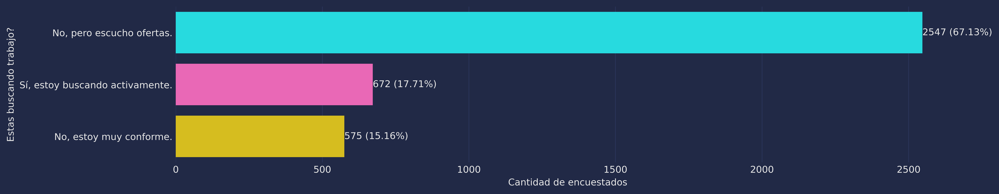

In [32]:
my_countplot(train, "estas_buscando_trabajo", figsize=(15, 3))
plt.xlabel("Cantidad de encuestados")
plt.ylabel("Estas buscando trabajo?");

Aparentemente muchos trabajadores no estan totalmente conformes con sus puestos actuales, a muchos les gustaria recibir ofertas nuevas y obviamente con mayores prestaciones. Las razones de estas disconformidades pueden ser muy variadas y excede al analisis que estamos realizando, pero seria interesante investigar mas sobre esto ya que seria util para aquellas empresas que quieran mantener a sus trabajadores por mas tiempo.

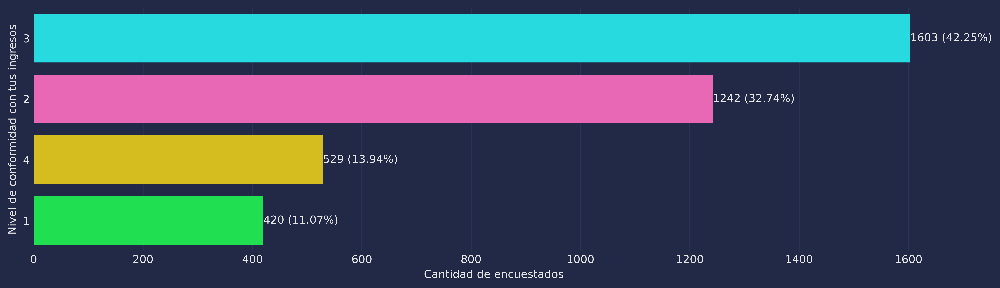

In [33]:
my_countplot(train, "conformidad_con_tus_ingresos", figsize=(15, 4))
plt.xlabel("Cantidad de encuestados")
plt.ylabel("Nivel de conformidad con tus ingresos");

Siendo 1 (poco conforme) a 4 (muy conforme) la escala de conformidad, como era de esperarse un gran porcentaje no esta muy conforme (2 y 3) con su sueldo actual, esto puede predisponer a los trabajadores a estar dispuestos a escuchar nuevas propuestas laborales.

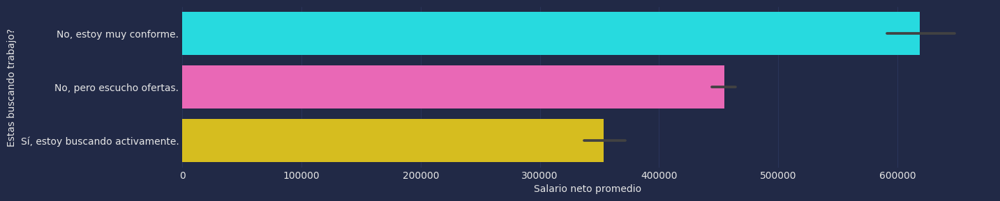

In [34]:
plt.figure(figsize=(15, 3))
sns.barplot(data=train, x="salario_neto", y="estas_buscando_trabajo", order=train.groupby(["estas_buscando_trabajo"]).salario_neto.mean().sort_values(ascending=False).index)
plt.xlabel("Salario neto promedio")
plt.ylabel("Estas buscando trabajo?");

Por ultimo, como se puede observar y como era de esperarse, parte de la disconformidad viene acompañada de la mano de salarios menores.

## Tipo de contrato

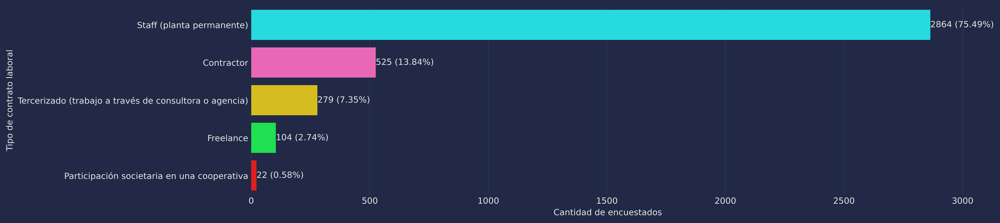

In [35]:
my_countplot(train, "tipo_de_contrato", figsize=(15, 4))
plt.xlabel("Cantidad de encuestados")
plt.ylabel("Tipo de contrato laboral");

La mayoria de trabajadores tiene puesto en planta permanente, cabe destacar que en Argentina este tambien es el mas comun.

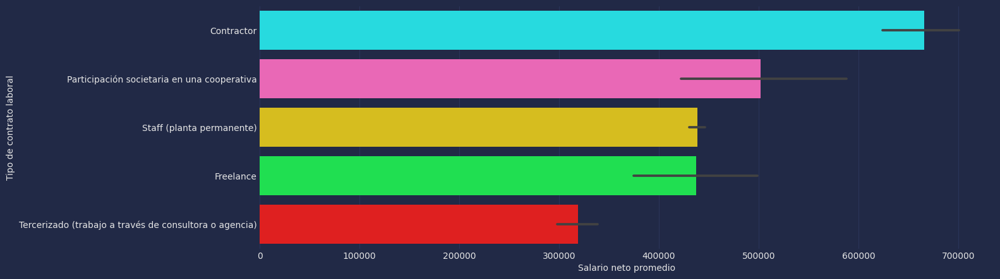

In [36]:
plt.figure(figsize=(15, 5))
sns.barplot(data=train, x="salario_neto", y="tipo_de_contrato", order=train.groupby(["tipo_de_contrato"]).salario_neto.mean().sort_values(ascending=False).index)
plt.xlabel("Salario neto promedio")
plt.ylabel("Tipo de contrato laboral");

Sin embargo, aquellas personas que tienen tipo de contrato como contractors perciben un mejor salario con respecto al resto de tipos de contratos.

# Puestos

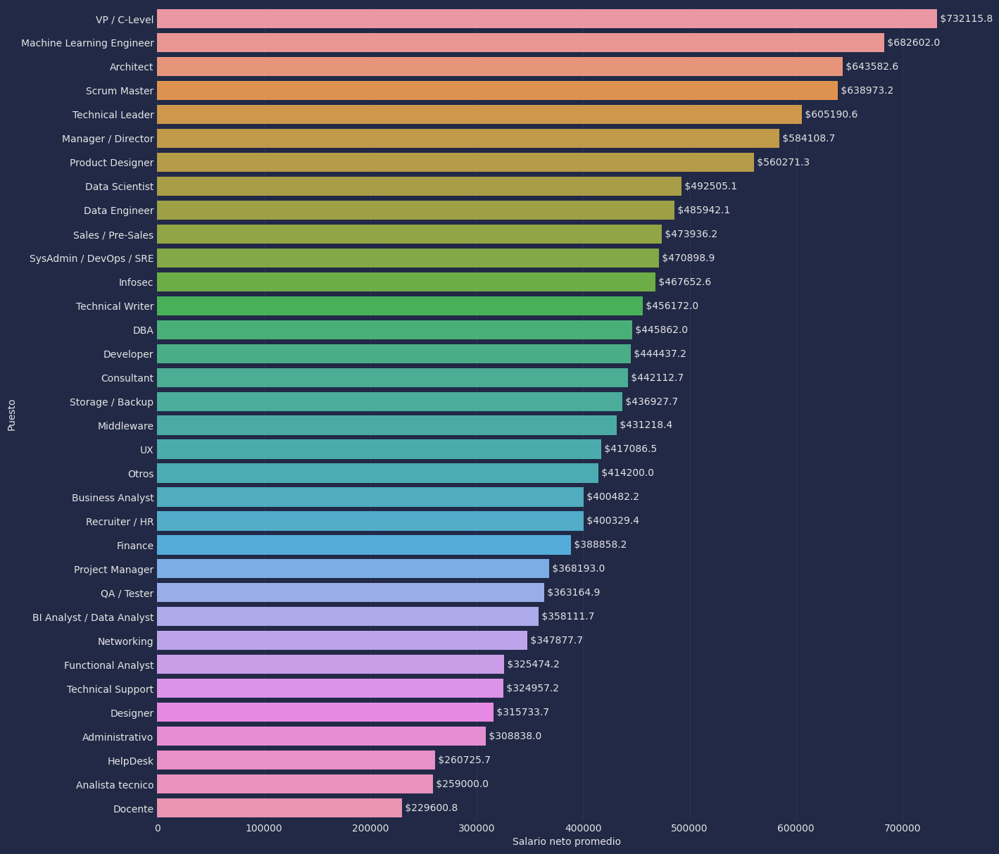

In [37]:
puestos = train["puesto"].value_counts()

for dataset in [train, test]:
    dataset.loc[dataset["puesto"].isin(puestos[puestos == 1].index), "puesto"] = "Otros"
    
plt.figure(figsize=(15, 15))
ax = sns.barplot(data=train, x="salario_neto", y="puesto", order=train.groupby(["puesto"]).salario_neto.mean().sort_values(ascending=False).index, errorbar=None)
abs_values = np.round(train.groupby(["puesto"]).salario_neto.mean().sort_values(ascending=False), 1)
lbls = [f' ${p[0]}' for p in zip(abs_values)]
ax.bar_label(container=ax.containers[0], labels=lbls);
plt.xlabel("Salario neto promedio")
plt.ylabel("Puesto");

## Salario neto por puesto y genero

Dejando de lado cualquier ideologia de genero, tendre en cuenta solamente 3 categorias, mujeres, hombres y otros de forma de minimizar la variedad de respuestas y poder trabajar con una cantidad de categorias mas reducida.

In [38]:
def replace_genre(row):
    text = str(row[0])
    if text != "Hombre Cis" and text != "Mujer Cis":
        return "Otros"
    else:
        return text

for dataset in [train, test]:
    dataset[["genero"]] = pd.DataFrame(dataset[["genero"]].apply(replace_genre, axis=1))

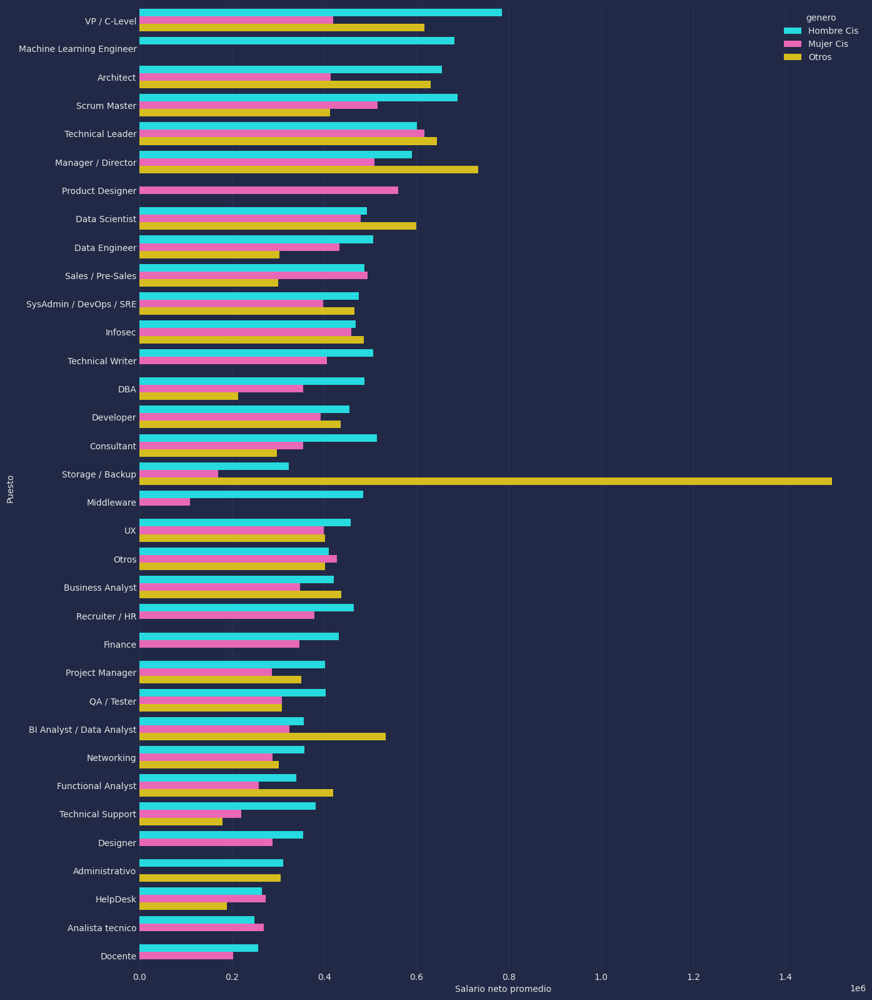

In [39]:
plt.figure(figsize=(15, 20))
sns.barplot(data=train, x="salario_neto", y="puesto", width=0.8, order=train.groupby(["puesto"]).salario_neto.mean().sort_values(ascending=False).index, errorbar=None, hue="genero")
plt.xlabel("Salario neto promedio")
plt.ylabel("Puesto");

## Salario neto por puesto y seniority

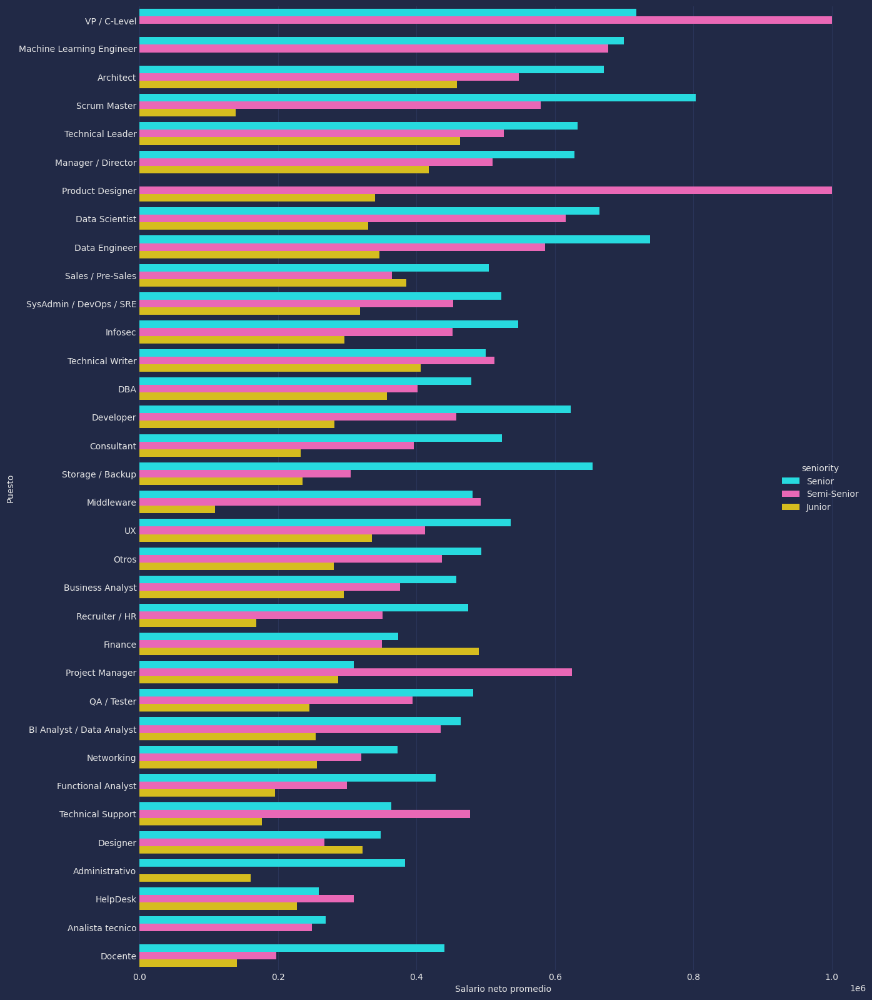

In [40]:
plt.figure(figsize=(15, 20))
sns.barplot(data=train, x="salario_neto", y="puesto", width=0.8, errorbar=None, order=train.groupby(["puesto"]).salario_neto.mean().sort_values(ascending=False).index, hue="seniority", hue_order=["Senior", "Semi-Senior", "Junior"])
plt.xlabel("Salario neto promedio")
plt.ylabel("Puesto");

## Salario neto

Esta variable esta fuertemente relacionada con el salario en bruto por lo que la analizaremos con mas detalle.

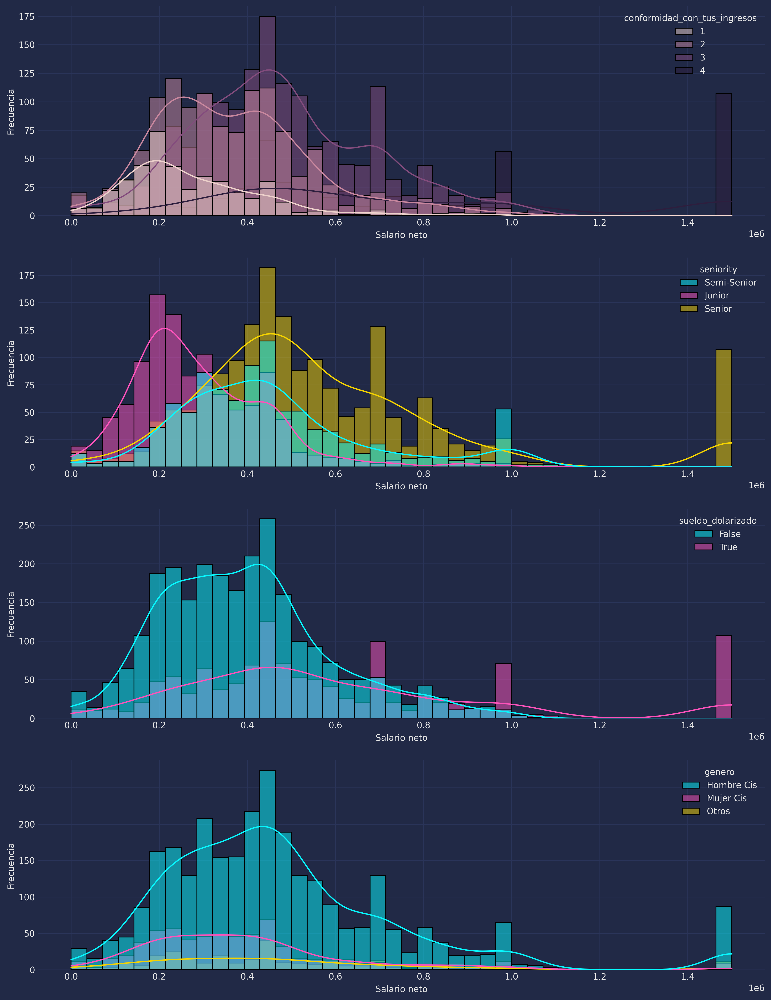

In [41]:
lista_de_interes = ["conformidad_con_tus_ingresos", "seniority", "sueldo_dolarizado", "genero"]

fig, axs = plt.subplots(4, 1, figsize=(15, 20), dpi=300)
for i, col in enumerate(lista_de_interes):
    plt.subplot(4, 1, i+1)
    sns.histplot(data=train, x="salario_neto", hue=col, kde=True);
    plt.xlabel("Salario neto")
    plt.ylabel("Frecuencia")

# Feature enconding
## Mapeo de caracteristicas

In [42]:
for dataset in [train, test]:
    dataset["actualizacion_de_ingresos"] = dataset["actualizacion_de_ingresos"].map({"No":0, "Uno":1, "Dos":2, "Tres":3, "Más de tres":4}).astype('int32')
    dataset["mes_del_ultimo_ajuste"] = dataset["mes_del_ultimo_ajuste"].map({"No tuve":0, "Enero":1, "Febrero":2, "Marzo":3, "Abril":4, "Mayo":5, "Junio":6, "Julio":7, "Agosto":8, "Septiembre":9, "Octubre":10, "Noviembre":11, "Diciembre":12})

## Label enconding

In [43]:
le_columns = ["puesto", "donde_estas_trabajando", "dedicacion", "tipo_de_contrato", "tipo_de_bono", "estas_buscando_trabajo", "modalidad_de_trabajo", "seniority"]

leS = {}
df_aux = pd.DataFrame()
for col in le_columns:
    leS[col] = LabelEncoder()
    for dataset in [train, test]:
        leS[col].fit(dataset[col])
        dataset[col] = leS[col].transform(dataset[col])
        
train[le_columns].head()

,puesto,donde_estas_trabajando,dedicacion,tipo_de_contrato,tipo_de_bono,estas_buscando_trabajo,modalidad_de_trabajo,seniority
579,10,0,0,3,3,1,1,1
4192,3,4,0,3,3,1,1,1
4554,10,6,0,3,3,1,0,0
5195,20,4,0,3,4,0,1,0
1685,2,4,0,3,3,0,1,2


## Trabajando sobre "Genero"


In [44]:
train["genero"].value_counts()

genero
Hombre Cis    2855
Mujer Cis      660
Otros          279
Name: count, dtype: int64

In [45]:
def replace_genre(row):
    text = str(row[0])
    if text == "Hombre Cis":
        return 0
    elif text == "Mujer Cis":
        return 1
    else:
        return 2

for dataset in [train, test]:
    dataset[["genero"]] = pd.DataFrame(dataset[["genero"]].apply(replace_genre, axis=1)).astype("int32")

# Feature Engineering

## Trabajando sobre "Cantidad de personas en tu organizacion"

In [46]:
train["cantidad_de_personas_en_tu_organizacion"].value_counts()

cantidad_de_personas_en_tu_organizacion
De 11  a 50  personas       625
De 201 a 500 personas       505
De 51 a 100 personas        458
Más de 10000 personas       454
De 101 a 200 personas       449
De 2001a 5000 personas      312
De 501 a 1000 personas      268
De 1001 a 2000 personas     260
De 2 a 10 personas          242
De 5001 a 10000 personas    182
1 (solamente yo)             39
Name: count, dtype: int64

No son tantos valores diferentes, pero sin embargo debemos procesarlos de forma tal de extraer informacion util, podemos extraer los valores numericos, y separarlos en valores minimos y maximos de personas.

In [47]:
def add_column(train, test, col):
    train = pd.concat([train, pd.DataFrame(columns=[col])], axis=1)
    test = pd.concat([test, pd.DataFrame(columns=[col])], axis=1)
    return train, test

def get_numbers(row):
    list_numbers = [float(s) for s in re.findall(r'-?\d+\.?\d*', str(row.values))]
    if len(list_numbers) == 1:
        list_numbers.append(list_numbers[0])
    return list_numbers

train, test = add_column(train, test, "min_de_personas")
train, test = add_column(train, test, "max_de_personas")

for dataset in [train, test]:
    dataset[["min_de_personas", "max_de_personas"]] = pd.DataFrame(dataset[["cantidad_de_personas_en_tu_organizacion"]].apply(get_numbers, axis=1, result_type='expand'))
    dataset.drop(["cantidad_de_personas_en_tu_organizacion"], axis=1, inplace=True)
    
train[["min_de_personas", "max_de_personas"]].head()

,min_de_personas,max_de_personas
579,1001.0,2000.0
4192,501.0,1000.0
4554,2.0,10.0
5195,51.0,100.0
1685,2001.0,5000.0


## Trabajando sobre "Beneficios adicionales"

In [48]:
train["beneficios_adicionales"].value_counts()

beneficios_adicionales
Ninguna de las anteriores                                                                                                                                                                                                                                     475
Horarios flexibles                                                                                                                                                                                                                                            200
Horarios flexibles, Vacaciones flexibles (adicionales a las reglamentarias)                                                                                                                                                                                    74
Capacitaciones y/o cursos                                                                                                                                                                                  

En este caso contamos con 2019 valores diferentes, es bastante complejo a simple vista encontrar algun patron que pueda ser de utilidad, una idea que se me ocurre surge de contabilizar la cantidad de beneficios adicionales que cada trabajador declaro.

In [49]:
def count_benefits(row):
    text = str(row.values[0])
    text = re.sub(r'\(.*?\)', '', text)
    return len(text.split(","))

train, test = add_column(train, test, "cantidad_beneficios_adicionales")

for dataset in [train, test]:
    dataset[["cantidad_beneficios_adicionales"]] = pd.DataFrame(dataset[["beneficios_adicionales"]].apply(count_benefits, axis=1)).astype("int32")
    
train[["cantidad_beneficios_adicionales"]].head()

,cantidad_beneficios_adicionales
579,8
4192,7
4554,1
5195,3
1685,5


### Extrayendo los beneficios mas otorgados

In [50]:
def cleaning_benefits(row):
    text = str(row.values[0])
    text = re.sub(r'\(.*?\)', '', text)
    return str(text)

clean_benefits = dataset[["beneficios_adicionales"]].apply(cleaning_benefits, axis=1)
benefits = list(set((", ".join(clean_benefits.value_counts().head(50).index.tolist()[1:])).split(", ")))

for i, benefit in enumerate(benefits):
    if benefit[-1] == " ":
        benefits[i] = benefit[:-1]

benefits

['Abono de Internet',
 'Stock options / RSUs',
 'Crédito en billeteras virtuales',
 'Abono de celular',
 'Comidas pagas / subvencionadas',
 'Horarios flexibles',
 'Capacitaciones y/o cursos',
 'Licencia por nacimiento extendida',
 'Vacaciones flexibles',
 'Clases de idiomas',
 'Descuento en gimnasios / Clases de gimnasia online',
 'Viáticos']

In [51]:
for benefit in benefits:
    train, test = add_column(train, test, "recibe_"+benefit)
    for dataset in [train, test]:
        dataset["recibe_"+benefit] = dataset["beneficios_adicionales"].str.contains(benefit, flags=re.IGNORECASE, regex=True).astype("int8")

        
train.rename(columns={"recibe_Descuento en gimnasios / Clases de gimnasia online":"recibe_beneficios_gimnasia"}, inplace=True)
test.rename(columns={"recibe_Descuento en gimnasios / Clases de gimnasia online":"recibe_beneficios_gimnasia"}, inplace=True)
        
train, test = add_column(train, test, "otros_beneficios")

for dataset in [train, test]:
    dataset["otros_beneficios"] = 0
    dataset.loc[dataset["cantidad_beneficios_adicionales"] > 0,"otros_beneficios"] = (~dataset[dataset["cantidad_beneficios_adicionales"] > 0]["beneficios_adicionales"].str.contains("|".join(benefits), flags=re.IGNORECASE, regex=True)).astype('int8').values
    dataset.drop(["beneficios_adicionales"], axis=1, inplace=True)

train.head()

,donde_estas_trabajando,dedicacion,tipo_de_contrato,salario_neto,tipo_de_bono,actualizacion_de_ingresos,ajuste_total_acumulado,mes_del_ultimo_ajuste,cuanto_mejoraron_tus_ingresos,conformidad_con_tus_ingresos,estas_buscando_trabajo,puesto,anos_de_experiencia,antiguedad,tiempo_en_el_puesto,personas_a_cargo,plataformas,frameworks/herramientas/librerias,bases_de_datos,qa_testing,modalidad_de_trabajo,dias_presenciales,recomendas_tu_empresa,uso_de_herramientas_de_ia,tengo_edad,genero,sueldo_dolarizado,seniority,min_de_personas,max_de_personas,cantidad_beneficios_adicionales,recibe_Abono de Internet,recibe_Stock options / RSUs,recibe_Crédito en billeteras virtuales,recibe_Abono de celular,recibe_Comidas pagas / subvencionadas,recibe_Horarios flexibles,recibe_Capacitaciones y/o cursos,recibe_Licencia por nacimiento extendida,recibe_Vacaciones flexibles,recibe_Clases de idiomas,recibe_beneficios_gimnasia,recibe_Viáticos,otros_beneficios
579,0,0,3,290414.0,3,1,50.0,1,3,2,1,10,3,2.0,2,0,Ninguna de las anteriores,"Next.js, React.js",PostgreSQL,Ninguna de las anteriores,1,5,7,2,32,0,True,1,1001.0,2000.0,8,1,1,0,0,0,0,1,1,0,1,1,0,0
4192,4,0,3,270000.0,3,2,30.0,3,1,1,1,3,3,0.0,0,0,"Docker, Tableau, teradata, airflow",Ninguno de los anteriores,"Microsoft SQL Server, PostgreSQL, Teradata",Ninguna de las anteriores,1,0,4,4,26,0,False,1,501.0,1000.0,7,1,0,0,0,0,1,0,0,1,1,1,0,0
4554,6,0,3,137000.0,3,1,20.0,5,3,2,1,10,1,1.0,1,0,"Docker, Google Cloud Platform, Linux","Bootstrap, jQuery, Laravel, Node.js, Vue.js, N...","MariaDB, MySQL",Ninguna de las anteriores,0,5,8,2,27,0,False,0,2.0,10.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
5195,4,0,3,308000.0,4,1,25.0,7,3,4,0,20,2,2.0,2,0,Ninguna de las anteriores,Ninguno de los anteriores,Ninguna de las anteriores,Ninguna de las anteriores,1,0,10,1,23,1,False,0,51.0,100.0,3,0,0,1,0,0,0,0,0,0,1,1,0,0
1685,4,0,3,700000.0,3,1,15.0,3,3,3,0,2,20,7.0,2,0,"Amazon Web Services, Azure, Docker, Google Clo...",Spring,Amazon DynamoDB,Appium,1,0,7,1,46,0,True,2,2001.0,5000.0,5,1,0,0,0,0,1,1,0,0,1,1,0,0


## Trabajando sobre "Plataformas"

In [52]:
train["plataformas"].value_counts()

plataformas
Ninguna de las anteriores                                              699
Azure                                                                  125
Linux                                                                  112
Docker, Linux                                                           96
Windows Server                                                          92
                                                                      ... 
Mainframe, Software propietario                                          1
Azure, Docker, Kubernetes, Linux, VMWare, Ninguna de las anteriores      1
Amazon Web Services, Azure, Linux, Microcontroladores                    1
Firebase, clickup, confluence                                            1
Firebase, Google Cloud Platform, Monday                                  1
Name: count, Length: 966, dtype: int64

Como hicimos con la caracteristica "Contas con beneficios adicionales", esta caracteristica al tener tantos valores categoricos diferentes, sera de mayor utilidad contabilizar las plataformas que utilizan en sus puestos actuales.

In [53]:
def count_platforms(row):
    text = str(row.values[0])
    if text == "Ninguna de las anteriores":
        return 0
    else:
        return len(text.split(","))

train, test = add_column(train, test, "cantidad_plataformas")

for dataset in [train, test]:
    dataset[["cantidad_plataformas"]] = pd.DataFrame(dataset[["plataformas"]].apply(count_platforms, axis=1)).astype("int32")

train[["cantidad_plataformas"]].head()

,cantidad_plataformas
579,0
4192,4
4554,3
5195,0
1685,7


### Extrayendo las plataformas mas usadas

In [54]:
plfs = list(set((", ".join(train["plataformas"].value_counts().head(50).index.tolist()[1:])).split(", ")))
plfs

['Mainframe',
 'Serverless',
 'Linux',
 'VMWare',
 'Google Cloud Platform',
 'OpenShift',
 'Salesforce',
 'Docker',
 'Firebase',
 'Amazon Web Services',
 'Windows Server',
 'Kubernetes',
 'Azure',
 'SAP']

In [55]:
for plf in plfs:
    train, test = add_column(train, test, "usa_"+plf)   
    for dataset in [train, test]:
        dataset["usa_"+plf] = dataset["plataformas"].str.contains(plf, flags=re.IGNORECASE, regex=True).astype("int8")

train, test = add_column(train, test, "usa_otros_plfs")

for dataset in [train, test]:
    dataset["usa_otros_plfs"] = 0
    dataset.loc[dataset["cantidad_plataformas"] > 0,"usa_otros_plfs"] = (~dataset[dataset["cantidad_plataformas"] > 0]["plataformas"].str.contains("|".join(plfs), flags=re.IGNORECASE, regex=True)).astype('int8').values
    dataset.drop(["plataformas"], axis=1, inplace=True)
    
train.head()

,donde_estas_trabajando,dedicacion,tipo_de_contrato,salario_neto,tipo_de_bono,actualizacion_de_ingresos,ajuste_total_acumulado,mes_del_ultimo_ajuste,cuanto_mejoraron_tus_ingresos,conformidad_con_tus_ingresos,estas_buscando_trabajo,puesto,anos_de_experiencia,antiguedad,tiempo_en_el_puesto,personas_a_cargo,frameworks/herramientas/librerias,bases_de_datos,qa_testing,modalidad_de_trabajo,dias_presenciales,recomendas_tu_empresa,uso_de_herramientas_de_ia,tengo_edad,genero,sueldo_dolarizado,seniority,min_de_personas,max_de_personas,cantidad_beneficios_adicionales,recibe_Abono de Internet,recibe_Stock options / RSUs,recibe_Crédito en billeteras virtuales,recibe_Abono de celular,recibe_Comidas pagas / subvencionadas,recibe_Horarios flexibles,recibe_Capacitaciones y/o cursos,recibe_Licencia por nacimiento extendida,recibe_Vacaciones flexibles,recibe_Clases de idiomas,recibe_beneficios_gimnasia,recibe_Viáticos,otros_beneficios,cantidad_plataformas,usa_Mainframe,usa_Serverless,usa_Linux,usa_VMWare,usa_Google Cloud Platform,usa_OpenShift,usa_Salesforce,usa_Docker,usa_Firebase,usa_Amazon Web Services,usa_Windows Server,usa_Kubernetes,usa_Azure,usa_SAP,usa_otros_plfs
579,0,0,3,290414.0,3,1,50.0,1,3,2,1,10,3,2.0,2,0,"Next.js, React.js",PostgreSQL,Ninguna de las anteriores,1,5,7,2,32,0,True,1,1001.0,2000.0,8,1,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4192,4,0,3,270000.0,3,2,30.0,3,1,1,1,3,3,0.0,0,0,Ninguno de los anteriores,"Microsoft SQL Server, PostgreSQL, Teradata",Ninguna de las anteriores,1,0,4,4,26,0,False,1,501.0,1000.0,7,1,0,0,0,0,1,0,0,1,1,1,0,0,4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
4554,6,0,3,137000.0,3,1,20.0,5,3,2,1,10,1,1.0,1,0,"Bootstrap, jQuery, Laravel, Node.js, Vue.js, N...","MariaDB, MySQL",Ninguna de las anteriores,0,5,8,2,27,0,False,0,2.0,10.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,3,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0
5195,4,0,3,308000.0,4,1,25.0,7,3,4,0,20,2,2.0,2,0,Ninguno de los anteriores,Ninguna de las anteriores,Ninguna de las anteriores,1,0,10,1,23,1,False,0,51.0,100.0,3,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1685,4,0,3,700000.0,3,1,15.0,3,3,3,0,2,20,7.0,2,0,Spring,Amazon DynamoDB,Appium,1,0,7,1,46,0,True,2,2001.0,5000.0,5,1,0,0,0,0,1,1,0,0,1,1,0,0,7,0,0,1,0,1,1,0,1,0,1,0,1,1,0,0


## Trabajando sobre "Frameworks/herramientas/librerias"

In [56]:
train["frameworks/herramientas/librerias"].value_counts()

frameworks/herramientas/librerias
Ninguno de los anteriores               1443
.NET Core                                113
Node.js                                   95
Spring                                    82
Node.js, React.js                         79
                                        ... 
Django, Hibernate, Spring                  1
Pytest, Allure                             1
Bootstrap, Drupal, Hibernate, Spring       1
BluePrism                                  1
Bootstrap, Flutter, jQuery, CakePHP        1
Name: count, Length: 922, dtype: int64

Como hicimos con la caracteristica "Contas con beneficios adicionales", esta caracteristica al tener tantos valores categoricos diferentes, sera de mayor utilidad contabilizar los frameworks o librerias que utilizan en sus puestos actuales.

In [57]:
def count_frameworks(row):
    text = str(row.values[0])
    if text in ["Ninguno de los anteriores", "No utilizo librerías", "Nose", "no uso", ".", "-", "Ninguno", "No", "Ninguna", "no", "0", "N/a"]:
        return 0
    return len(text.split(","))

train, test = add_column(train, test, "cantidad_herramientas")

for dataset in [train, test]:
    dataset[["cantidad_herramientas"]] = pd.DataFrame(dataset[["frameworks/herramientas/librerias"]].apply(count_frameworks, axis=1)).astype("int32")
    
train[["cantidad_herramientas"]].head()

,cantidad_herramientas
579,2
4192,0
4554,6
5195,0
1685,1


### Extrayendo las frameworks/herramientas/librerias mas usados

In [58]:
frws = list(set((", ".join(train["frameworks/herramientas/librerias"].value_counts().head(50).index.tolist()[1:])).split(", ")))
frws.remove("")
frws.remove("Ninguno de los anteriores")
frws

['Hibernate',
 'Django',
 'Angular',
 'jQuery',
 'Rails',
 'React.js',
 'Laravel',
 'Spring',
 'SAP',
 'Hadoop',
 'Bootstrap',
 'Flask',
 'Spark',
 '.NET Core',
 'Vue.js',
 'Next.js',
 'Node.js',
 'WordPress',
 'TensorFlow']

In [59]:
for frw in frws:
    train, test = add_column(train, test, "usa_"+frw)
    for dataset in [train, test]:
        dataset["usa_"+frw] = dataset["frameworks/herramientas/librerias"].str.contains(frw, flags=re.IGNORECASE, regex=True).astype("int8")

train, test = add_column(train, test, "usa_otros_frws")        

for dataset in [train, test]:
    dataset["usa_otros_frws"] = 0
    dataset.loc[dataset["cantidad_herramientas"] > 0,"usa_otros_frws"] = (~dataset[dataset["cantidad_herramientas"] > 0]["frameworks/herramientas/librerias"].str.contains("|".join(frws), flags=re.IGNORECASE, regex=True)).astype('int8').values
    dataset.drop(["frameworks/herramientas/librerias"], axis=1, inplace=True)
    
train.head()

,donde_estas_trabajando,dedicacion,tipo_de_contrato,salario_neto,tipo_de_bono,actualizacion_de_ingresos,ajuste_total_acumulado,mes_del_ultimo_ajuste,cuanto_mejoraron_tus_ingresos,conformidad_con_tus_ingresos,estas_buscando_trabajo,puesto,anos_de_experiencia,antiguedad,tiempo_en_el_puesto,personas_a_cargo,bases_de_datos,qa_testing,modalidad_de_trabajo,dias_presenciales,recomendas_tu_empresa,uso_de_herramientas_de_ia,tengo_edad,genero,sueldo_dolarizado,seniority,min_de_personas,max_de_personas,cantidad_beneficios_adicionales,recibe_Abono de Internet,recibe_Stock options / RSUs,recibe_Crédito en billeteras virtuales,recibe_Abono de celular,recibe_Comidas pagas / subvencionadas,recibe_Horarios flexibles,recibe_Capacitaciones y/o cursos,recibe_Licencia por nacimiento extendida,recibe_Vacaciones flexibles,recibe_Clases de idiomas,recibe_beneficios_gimnasia,recibe_Viáticos,otros_beneficios,cantidad_plataformas,usa_Mainframe,usa_Serverless,usa_Linux,usa_VMWare,usa_Google Cloud Platform,usa_OpenShift,usa_Salesforce,usa_Docker,usa_Firebase,usa_Amazon Web Services,usa_Windows Server,usa_Kubernetes,usa_Azure,usa_SAP,usa_otros_plfs,cantidad_herramientas,usa_Hibernate,usa_Django,usa_Angular,usa_jQuery,usa_Rails,usa_React.js,usa_Laravel,usa_Spring,usa_SAP,usa_Hadoop,usa_Bootstrap,usa_Flask,usa_Spark,usa_.NET Core,usa_Vue.js,usa_Next.js,usa_Node.js,usa_WordPress,usa_TensorFlow,usa_otros_frws
579,0,0,3,290414.0,3,1,50.0,1,3,2,1,10,3,2.0,2,0,PostgreSQL,Ninguna de las anteriores,1,5,7,2,32,0,True,1,1001.0,2000.0,8,1,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4192,4,0,3,270000.0,3,2,30.0,3,1,1,1,3,3,0.0,0,0,"Microsoft SQL Server, PostgreSQL, Teradata",Ninguna de las anteriores,1,0,4,4,26,0,False,1,501.0,1000.0,7,1,0,0,0,0,1,0,0,1,1,1,0,0,4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4554,6,0,3,137000.0,3,1,20.0,5,3,2,1,10,1,1.0,1,0,"MariaDB, MySQL",Ninguna de las anteriores,0,5,8,2,27,0,False,0,2.0,10.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,3,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,6,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0
5195,4,0,3,308000.0,4,1,25.0,7,3,4,0,20,2,2.0,2,0,Ninguna de las anteriores,Ninguna de las anteriores,1,0,10,1,23,1,False,0,51.0,100.0,3,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1685,4,0,3,700000.0,3,1,15.0,3,3,3,0,2,20,7.0,2,0,Amazon DynamoDB,Appium,1,0,7,1,46,0,True,2,2001.0,5000.0,5,1,0,0,0,0,1,1,0,0,1,1,0,0,7,0,0,1,0,1,1,0,1,0,1,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0


## Trabajando sobre "Bases de datos"

In [60]:
train["bases_de_datos"].value_counts()

bases_de_datos
Ninguna de las anteriores                                                       862
Microsoft SQL Server                                                            296
MySQL                                                                           218
PostgreSQL                                                                      157
Oracle                                                                          131
                                                                               ... 
Microsoft SQL Server, MySQL, Oracle, PostgreSQL, Redis, SQLite                    1
Informix, Microsoft SQL Server, MySQL, PostgreSQL                                 1
Amazon RDS/Aurora, ElasticSearch, PostgreSQL                                      1
Amazon DynamoDB, Amazon Redshift, Amazon RDS/Aurora, Apache Hive, PostgreSQL      1
ElasticSearch, PostgreSQL, Redis                                                  1
Name: count, Length: 879, dtype: int64

Como hicimos con la caracteristica "Contas con beneficios adicionales", esta caracteristica al tener tantos valores categoricos diferentes, sera de mayor utilidad contabilizar las bases de datos que utilizan en sus puestos actuales.

In [61]:
def count_dbs(row):
    text = str(row.values[0])
    text = re.sub(r'\(.*?\)', '', text)
    if text in ["Ninguno de los anteriores", "dgsdgsdgdfdfh", "Ninguna", "No lo se", "a", "No estoy dentro de tecnología", "no manejo DB en este proyecto", "Ninguna de las anteriores", "no uso", "API de la companía que interactúa con DBs en AWS", "no lo se con seguridad", "No aplica a mi puesto", "0", "no accedo directamente a ninguna plataforma.", "-", "Mi puesto es comercial. Vendo un producto desarrollado en la empresa", "x", "no", "No", ".", "....", "todo", "Desconozco", "estoy en Design"]:
        return 0
    return len(text.split(","))

train, test = add_column(train, test, "cantidad_bases_de_datos") 

for dataset in [train, test]:
    dataset[["cantidad_bases_de_datos"]] = pd.DataFrame(dataset[["bases_de_datos"]].apply(count_dbs, axis=1)).astype("int32")

train[["cantidad_bases_de_datos"]].head()

,cantidad_bases_de_datos
579,1
4192,3
4554,2
5195,0
1685,1


### Extrayendo las bases de datos mas usadas

In [62]:
dbs = list(set((", ".join(train["bases_de_datos"].value_counts().head(50).index.tolist()[1:])).split(", ")))
dbs.remove("etc)")
for i, item in enumerate(dbs):
    if item == "Microsoft Azure (Tables":
        dbs[i] = "Microsoft Azure"
dbs

['SQLite',
 'Microsoft Azure',
 'MariaDB',
 'Microsoft SQL Server',
 'MySQL',
 'IBM Db2',
 'Amazon DynamoDB',
 'Teradata',
 'PostgreSQL',
 'CosmosDB',
 'HANA',
 'MongoDB',
 'Google Cloud Storage',
 'Oracle',
 'SQL',
 'Redis',
 'ElasticSearch',
 'Amazon RDS/Aurora']

In [63]:
for db in dbs:
    train, test = add_column(train, test, "usa_"+db) 
    for dataset in [train, test]:
        dataset["usa_"+db] = dataset["bases_de_datos"].str.contains(db, flags=re.IGNORECASE, regex=True).astype("int8")

train, test = add_column(train, test, "usa_otras_dbs") 
        
for dataset in [train, test]:
    dataset["usa_otras_dbs"] = 0
    dataset.loc[dataset["cantidad_bases_de_datos"] > 0,"usa_otras_dbs"] = (~dataset[dataset["cantidad_bases_de_datos"] > 0]["bases_de_datos"].str.contains("|".join(dbs), flags=re.IGNORECASE, regex=True)).astype('int8').values
    dataset.drop(["bases_de_datos"], axis=1, inplace=True)
    
train.head()

,donde_estas_trabajando,dedicacion,tipo_de_contrato,salario_neto,tipo_de_bono,actualizacion_de_ingresos,ajuste_total_acumulado,mes_del_ultimo_ajuste,cuanto_mejoraron_tus_ingresos,conformidad_con_tus_ingresos,estas_buscando_trabajo,puesto,anos_de_experiencia,antiguedad,tiempo_en_el_puesto,personas_a_cargo,qa_testing,modalidad_de_trabajo,dias_presenciales,recomendas_tu_empresa,uso_de_herramientas_de_ia,tengo_edad,genero,sueldo_dolarizado,seniority,min_de_personas,max_de_personas,cantidad_beneficios_adicionales,recibe_Abono de Internet,recibe_Stock options / RSUs,recibe_Crédito en billeteras virtuales,recibe_Abono de celular,recibe_Comidas pagas / subvencionadas,recibe_Horarios flexibles,recibe_Capacitaciones y/o cursos,recibe_Licencia por nacimiento extendida,recibe_Vacaciones flexibles,recibe_Clases de idiomas,recibe_beneficios_gimnasia,recibe_Viáticos,otros_beneficios,cantidad_plataformas,usa_Mainframe,usa_Serverless,usa_Linux,usa_VMWare,usa_Google Cloud Platform,usa_OpenShift,usa_Salesforce,usa_Docker,usa_Firebase,usa_Amazon Web Services,usa_Windows Server,usa_Kubernetes,usa_Azure,usa_SAP,usa_otros_plfs,cantidad_herramientas,usa_Hibernate,usa_Django,usa_Angular,usa_jQuery,usa_Rails,usa_React.js,usa_Laravel,usa_Spring,usa_SAP,usa_Hadoop,usa_Bootstrap,usa_Flask,usa_Spark,usa_.NET Core,usa_Vue.js,usa_Next.js,usa_Node.js,usa_WordPress,usa_TensorFlow,usa_otros_frws,cantidad_bases_de_datos,usa_SQLite,usa_Microsoft Azure,usa_MariaDB,usa_Microsoft SQL Server,usa_MySQL,usa_IBM Db2,usa_Amazon DynamoDB,usa_Teradata,usa_PostgreSQL,usa_CosmosDB,usa_HANA,usa_MongoDB,usa_Google Cloud Storage,usa_Oracle,usa_SQL,usa_Redis,usa_ElasticSearch,usa_Amazon RDS/Aurora,usa_otras_dbs
579,0,0,3,290414.0,3,1,50.0,1,3,2,1,10,3,2.0,2,0,Ninguna de las anteriores,1,5,7,2,32,0,True,1,1001.0,2000.0,8,1,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0
4192,4,0,3,270000.0,3,2,30.0,3,1,1,1,3,3,0.0,0,0,Ninguna de las anteriores,1,0,4,4,26,0,False,1,501.0,1000.0,7,1,0,0,0,0,1,0,0,1,1,1,0,0,4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0
4554,6,0,3,137000.0,3,1,20.0,5,3,2,1,10,1,1.0,1,0,Ninguna de las anteriores,0,5,8,2,27,0,False,0,2.0,10.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,3,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,6,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,2,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
5195,4,0,3,308000.0,4,1,25.0,7,3,4,0,20,2,2.0,2,0,Ninguna de las anteriores,1,0,10,1,23,1,False,0,51.0,100.0,3,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1685,4,0,3,700000.0,3,1,15.0,3,3,3,0,2,20,7.0,2,0,Appium,1,0,7,1,46,0,True,2,2001.0,5000.0,5,1,0,0,0,0,1,1,0,0,1,1,0,0,7,0,0,1,0,1,1,0,1,0,1,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0


## Trabajando sobre "QA testing"

In [64]:
train["qa_testing"].value_counts()

qa_testing
Ninguna de las anteriores                                                               2167
Postman                                                                                  270
Jest                                                                                     121
JUnit                                                                                    100
JUnit, Postman                                                                            63
                                                                                        ... 
JUnit, NUnit, Visual Studio Coded UI                                                       1
Appium, Cucumber, HP UFT, Postman, Selenium, Visual Studio Coded UI, Pycharm, JMeter       1
Cypress, Jest, Storybook                                                                   1
Cucumber, JUnit, NUnit, Postman, Selenium, KIWI                                            1
Herramienta de la empresa                                  

Como hicimos con la caracteristica "Contas con beneficios adicionales", esta caracteristica al tener tantos valores categoricos diferentes, sera de mayor utilidad contabilizar las herramientas de QA Testing que utilizan en sus puestos actuales.

In [65]:
def count_qaTools(row):
    text = str(row.values[0])
    if text in ["Ninguna de las anteriores", "-", ".", "0", "no", "No", "Ninguna", "ninguna", "Ninguno", "No sabe no contesta", "No se", "Directamente ninguna", "No me dedico a testing", "xxx", "a", "Ns", "No aplicamos", "no se", "No estoy dentro de tecnología", "WTF", "Desconozco", "na", "non", "No usamos", "No utilizo", "x", "NS/NC"]:
        return 0
    return len(text.split(","))

train, test = add_column(train, test, "cantidad_qa_testing") 

for dataset in [train, test]:
    dataset[["cantidad_qa_testing"]] = pd.DataFrame(dataset[["qa_testing"]].apply(count_qaTools, axis=1)).astype("int32")

train[["cantidad_qa_testing"]].head()

,cantidad_qa_testing
579,0
4192,0
4554,0
5195,0
1685,1


### Extrayendo las herramientas de QA Testing mas usadas

In [66]:
qa_tools = list(set((", ".join(train["qa_testing"].value_counts().head(50).index.tolist()[1:])).split(", ")))
qa_tools.remove("")
qa_tools.remove("Ninguna de las anteriores")
qa_tools.remove("-")
qa_tools

['Cucumber',
 'NUnit',
 'Cypress',
 'JUnit',
 'SoapUI',
 'Selenium',
 'Test Complete',
 'RSpec',
 'PHPUnit',
 'Visual Studio Coded UI',
 'Karma',
 'Xunit',
 'Mocha',
 'Postman',
 'Jest',
 'TFS']

In [67]:
for qa in qa_tools:
    train, test = add_column(train, test, "usa_"+qa) 
    for dataset in [train, test]:
        dataset["usa_"+qa] = dataset["qa_testing"].str.contains(qa, flags=re.IGNORECASE, regex=True).copy().astype("int8")

train, test = add_column(train, test, "usa_otras_qa_tools") 
        
for dataset in [train, test]:
    dataset["usa_otras_qa_tools"] = 0
    dataset.loc[dataset["cantidad_qa_testing"] > 0,"usa_otras_qa_tools"] = (~dataset[dataset["cantidad_qa_testing"] > 0]["qa_testing"].str.contains("|".join(qa_tools), flags=re.IGNORECASE, regex=True)).astype('int8').values
    dataset.drop(["qa_testing"], axis=1, inplace=True)
    
train.head()

,donde_estas_trabajando,dedicacion,tipo_de_contrato,salario_neto,tipo_de_bono,actualizacion_de_ingresos,ajuste_total_acumulado,mes_del_ultimo_ajuste,cuanto_mejoraron_tus_ingresos,conformidad_con_tus_ingresos,estas_buscando_trabajo,puesto,anos_de_experiencia,antiguedad,tiempo_en_el_puesto,personas_a_cargo,modalidad_de_trabajo,dias_presenciales,recomendas_tu_empresa,uso_de_herramientas_de_ia,tengo_edad,genero,sueldo_dolarizado,seniority,min_de_personas,max_de_personas,cantidad_beneficios_adicionales,recibe_Abono de Internet,recibe_Stock options / RSUs,recibe_Crédito en billeteras virtuales,recibe_Abono de celular,recibe_Comidas pagas / subvencionadas,recibe_Horarios flexibles,recibe_Capacitaciones y/o cursos,recibe_Licencia por nacimiento extendida,recibe_Vacaciones flexibles,recibe_Clases de idiomas,recibe_beneficios_gimnasia,recibe_Viáticos,otros_beneficios,cantidad_plataformas,usa_Mainframe,usa_Serverless,usa_Linux,usa_VMWare,usa_Google Cloud Platform,usa_OpenShift,usa_Salesforce,usa_Docker,usa_Firebase,usa_Amazon Web Services,usa_Windows Server,usa_Kubernetes,usa_Azure,usa_SAP,usa_otros_plfs,cantidad_herramientas,usa_Hibernate,usa_Django,usa_Angular,usa_jQuery,usa_Rails,usa_React.js,usa_Laravel,usa_Spring,usa_SAP,usa_Hadoop,usa_Bootstrap,usa_Flask,usa_Spark,usa_.NET Core,usa_Vue.js,usa_Next.js,usa_Node.js,usa_WordPress,usa_TensorFlow,usa_otros_frws,cantidad_bases_de_datos,usa_SQLite,usa_Microsoft Azure,usa_MariaDB,usa_Microsoft SQL Server,usa_MySQL,usa_IBM Db2,usa_Amazon DynamoDB,usa_Teradata,usa_PostgreSQL,usa_CosmosDB,usa_HANA,usa_MongoDB,usa_Google Cloud Storage,usa_Oracle,usa_SQL,usa_Redis,usa_ElasticSearch,usa_Amazon RDS/Aurora,usa_otras_dbs,cantidad_qa_testing,usa_Cucumber,usa_NUnit,usa_Cypress,usa_JUnit,usa_SoapUI,usa_Selenium,usa_Test Complete,usa_RSpec,usa_PHPUnit,usa_Visual Studio Coded UI,usa_Karma,usa_Xunit,usa_Mocha,usa_Postman,usa_Jest,usa_TFS,usa_otras_qa_tools
579,0,0,3,290414.0,3,1,50.0,1,3,2,1,10,3,2.0,2,0,1,5,7,2,32,0,True,1,1001.0,2000.0,8,1,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4192,4,0,3,270000.0,3,2,30.0,3,1,1,1,3,3,0.0,0,0,1,0,4,4,26,0,False,1,501.0,1000.0,7,1,0,0,0,0,1,0,0,1,1,1,0,0,4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4554,6,0,3,137000.0,3,1,20.0,5,3,2,1,10,1,1.0,1,0,0,5,8,2,27,0,False,0,2.0,10.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,3,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,6,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,2,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5195,4,0,3,308000.0,4,1,25.0,7,3,4,0,20,2,2.0,2,0,1,0,10,1,23,1,False,0,51.0,100.0,3,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1685,4,0,3,700000.0,3,1,15.0,3,3,3,0,2,20,7.0,2,0,1,0,7,1,46,0,True,2,2001.0,5000.0,5,1,0,0,0,0,1,1,0,0,1,1,0,0,7,0,0,1,0,1,1,0,1,0,1,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


## Trabajando sobre el target multilabel "Lenguajes de programacion/tecnologias"

In [68]:
y_train["lenguajes_de_programacion/tecnologias"].value_counts()

lenguajes_de_programacion/tecnologias
Ninguno de los anteriores                   594
SQL                                         185
Python                                      135
Python, SQL                                 130
CSS, HTML, Javascript, TypeScript            78
                                           ... 
Java, Javascript, Scala, SQL, TypeScript      1
Java, Rust, SQL, Apex                         1
Go, Python, R, Scala, SQL                     1
SQL, Visual foxpro                            1
CSS, HTML, Javascript, TypeScript, VBA        1
Name: count, Length: 1075, dtype: int64

### Contando cantidad de lenguajes y/o tecnologias

In [69]:
def count_languages(row):
    text = str(row.values[0])
    if text in ["Ninguno de los anteriores", "No estoy dentro de tecnología", "-", "Ninguna", "Ninguno", "0", "no programo", ".", "No", "no", "No utilizo lenguajes de programación", "no aplica"]:
        return 0
    return len(text.split(","))

train, test = add_column(train, test, "cantidad_lenguajes/tecnologias")

train[["cantidad_lenguajes/tecnologias"]] = pd.DataFrame(y_train[["lenguajes_de_programacion/tecnologias"]].apply(count_languages, axis=1)).astype("int32")
test[["cantidad_lenguajes/tecnologias"]] = pd.DataFrame(y_test[["lenguajes_de_programacion/tecnologias"]].apply(count_languages, axis=1)).astype("int32")

train[["cantidad_lenguajes/tecnologias"]].head()

,cantidad_lenguajes/tecnologias
579,3
4192,2
4554,6
5195,0
1685,1


### Preparando el target para la tarea de clasificacion

In [70]:
languages = ["Python", "HTML", "CSS", "Java", "C#", "JavaScript", "TypeScript", "PHP", ".NET", "SQL", "Bash/Shell"]
for language in languages:
    for y_dataset in [y_train, y_test]:
        y_dataset[language] = y_dataset["lenguajes_de_programacion/tecnologias"].str.contains(language, flags=re.IGNORECASE, regex=True).astype("int8")

reg = "|".join(["Python", "HTML", "CSS", "Java", "C#", "JavaScript", "TypeScript", "PHP", ".NET", "SQL", "Bash/Shell"])
for y_dataset in [y_train, y_test]:
    y_dataset["Otros"] = (~y_dataset["lenguajes_de_programacion/tecnologias"].str.contains(reg, flags=re.IGNORECASE, regex=True)).astype("int8").values
    y_dataset.drop(["lenguajes_de_programacion/tecnologias"], axis=1, inplace=True)
    
y_train.head()

,salario_bruto,Python,HTML,CSS,Java,C#,JavaScript,TypeScript,PHP,.NET,SQL,Bash/Shell,Otros
579,349896.05,0,1,1,1,0,1,0,0,0,0,0,0
4192,320000.00,1,0,0,0,0,0,0,0,0,1,0,0
4554,137000.00,0,1,1,1,0,1,1,1,0,0,1,0
5195,375000.00,0,0,0,0,0,0,0,0,0,0,0,1
1685,2155000.00,0,0,0,1,0,0,0,0,0,0,0,0


Finalmente podemos ver que todas las caracteristicas exceptuando nuestros targets han sido transformados a caracteristicas numericas.

In [71]:
train.head()

,donde_estas_trabajando,dedicacion,tipo_de_contrato,salario_neto,tipo_de_bono,actualizacion_de_ingresos,ajuste_total_acumulado,mes_del_ultimo_ajuste,cuanto_mejoraron_tus_ingresos,conformidad_con_tus_ingresos,estas_buscando_trabajo,puesto,anos_de_experiencia,antiguedad,tiempo_en_el_puesto,personas_a_cargo,modalidad_de_trabajo,dias_presenciales,recomendas_tu_empresa,uso_de_herramientas_de_ia,tengo_edad,genero,sueldo_dolarizado,seniority,min_de_personas,max_de_personas,cantidad_beneficios_adicionales,recibe_Abono de Internet,recibe_Stock options / RSUs,recibe_Crédito en billeteras virtuales,recibe_Abono de celular,recibe_Comidas pagas / subvencionadas,recibe_Horarios flexibles,recibe_Capacitaciones y/o cursos,recibe_Licencia por nacimiento extendida,recibe_Vacaciones flexibles,recibe_Clases de idiomas,recibe_beneficios_gimnasia,recibe_Viáticos,otros_beneficios,cantidad_plataformas,usa_Mainframe,usa_Serverless,usa_Linux,usa_VMWare,usa_Google Cloud Platform,usa_OpenShift,usa_Salesforce,usa_Docker,usa_Firebase,usa_Amazon Web Services,usa_Windows Server,usa_Kubernetes,usa_Azure,usa_SAP,usa_otros_plfs,cantidad_herramientas,usa_Hibernate,usa_Django,usa_Angular,usa_jQuery,usa_Rails,usa_React.js,usa_Laravel,usa_Spring,usa_SAP,usa_Hadoop,usa_Bootstrap,usa_Flask,usa_Spark,usa_.NET Core,usa_Vue.js,usa_Next.js,usa_Node.js,usa_WordPress,usa_TensorFlow,usa_otros_frws,cantidad_bases_de_datos,usa_SQLite,usa_Microsoft Azure,usa_MariaDB,usa_Microsoft SQL Server,usa_MySQL,usa_IBM Db2,usa_Amazon DynamoDB,usa_Teradata,usa_PostgreSQL,usa_CosmosDB,usa_HANA,usa_MongoDB,usa_Google Cloud Storage,usa_Oracle,usa_SQL,usa_Redis,usa_ElasticSearch,usa_Amazon RDS/Aurora,usa_otras_dbs,cantidad_qa_testing,usa_Cucumber,usa_NUnit,usa_Cypress,usa_JUnit,usa_SoapUI,usa_Selenium,usa_Test Complete,usa_RSpec,usa_PHPUnit,usa_Visual Studio Coded UI,usa_Karma,usa_Xunit,usa_Mocha,usa_Postman,usa_Jest,usa_TFS,usa_otras_qa_tools,cantidad_lenguajes/tecnologias
579,0,0,3,290414.0,3,1,50.0,1,3,2,1,10,3,2.0,2,0,1,5,7,2,32,0,True,1,1001.0,2000.0,8,1,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
4192,4,0,3,270000.0,3,2,30.0,3,1,1,1,3,3,0.0,0,0,1,0,4,4,26,0,False,1,501.0,1000.0,7,1,0,0,0,0,1,0,0,1,1,1,0,0,4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
4554,6,0,3,137000.0,3,1,20.0,5,3,2,1,10,1,1.0,1,0,0,5,8,2,27,0,False,0,2.0,10.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,3,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,6,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,2,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6
5195,4,0,3,308000.0,4,1,25.0,7,3,4,0,20,2,2.0,2,0,1,0,10,1,23,1,False,0,51.0,100.0,3,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1685,4,0,3,700000.0,3,1,15.0,3,3,3,0,2,20,7.0,2,0,1,0,7,1,46,0,True,2,2001.0,5000.0,5,1,0,0,0,0,1,1,0,0,1,1,0,0,7,0,0,1,0,1,1,0,1,0,1,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1


# Correlaciones

In [72]:
corr = pd.concat([train, y_train], axis=1).corr()
plt.figure(figsize=(15, 15), dpi=700)
sns.heatmap(corr, cmap="plasma", vmin=-1, vmax=1, mask=np.abs(corr) < 0.15);

## Detectando problemas de multicolinealidad
Citando al sitio [MaximaFormacion](https://www.maximaformacion.es/blog-ciencia-datos/que-es-la-multicolinealidad-y-por-que-es-un-problema/#:~:text=is-multicollinearity-c5582ddbb2f7-,¿Qué%20es%20la%20multicolinealidad%20en%20pocas%20palabras%3F,independientes%20deberían%20ser%20eso%2C%20independientes.):

> La multicolinealidad ocurre cuando las variables independientes (predictores) en un modelo de regresión están correlacionadas. 
> 
> Las variables independientes deberían ser eso, independientes. Y esto se debe a que si el grado de correlación entre las variables independientes es alto, no podremos aislar la relación entre cada variable independiente y la variable dependiente (respuesta). 
> 
> ¡Si no podremos aislar los efectos podríamos confundir sus efectos!
> 
> Es decir, cuando las variables independientes están muy correlacionadas los cambios en una variable están asociados con cambios en otra variable y, por tanto, los coeficientes de regresión del modelo ya no van a medir el efecto de una variable independiente sobre la respuesta manteniendo constante, o sin variar, el resto de predictores. 

Entendiendo esto, procedamos a detectar problemas de multicolinealidad.

In [73]:
train["sueldo_dolarizado"] = train["sueldo_dolarizado"].astype("int8")
print(f"Contamos con {train.shape[1]} caracteristicas")

Contamos con 116 caracteristicas


In [74]:
def detect_VIF(train):
    train_ = train.copy()
    train_['intercept'] = 1
    with np.errstate(divide='ignore'):
        while(True):
            train_vif = pd.DataFrame(columns=["Features", "VIF"])
            train_vif["Features"] = train_.columns
            train_vif["VIF"] = [variance_inflation_factor(train_.values, i) for i in range(len(train_.columns))]
            train_vif = train_vif[train_vif["Features"] != "intercept"].sort_values("VIF", ascending=False)
            if train_vif.iloc[0]["VIF"] > 5:
                train_.drop([train_vif.iloc[0]["Features"]], axis=1, inplace=True)
            else:
                break
    train_.drop(["intercept"], axis=1, inplace=True)
    return train[train_.columns.tolist()].copy(), train_vif.reset_index(drop=True)
        
train_clean, train_vif = detect_VIF(train)
train_vif

,Features,VIF
0,anos_de_experiencia,3.929830
1,seniority,3.410602
2,usa_SQL,2.979543
3,conformidad_con_tus_ingresos,2.914335
4,mes_del_ultimo_ajuste,2.900631
...,...,...
102,usa_Salesforce,1.074824
103,donde_estas_trabajando,1.068322
104,usa_HANA,1.068003
105,usa_otras_qa_tools,1.063041


In [75]:
print(f"Despues de la deteccion y eliminacion por problemas de multicolinealidad reducimos el set a {train_clean.shape[1]} caracteristicas")

Despues de la deteccion y eliminacion por problemas de multicolinealidad reducimos el set a 107 caracteristicas


In [76]:
test = test[train_clean.columns].copy()

for col in train.columns:
    if col not in train_clean.columns:
        print(col, "(Caracteristica eliminada)")

max_de_personas (Caracteristica eliminada)
cantidad_beneficios_adicionales (Caracteristica eliminada)
cantidad_plataformas (Caracteristica eliminada)
usa_SAP (Caracteristica eliminada)
cantidad_herramientas (Caracteristica eliminada)
usa_SAP (Caracteristica eliminada)
cantidad_bases_de_datos (Caracteristica eliminada)
usa_Microsoft Azure (Caracteristica eliminada)
cantidad_qa_testing (Caracteristica eliminada)


In [77]:
corr = pd.concat([train_clean, y_train], axis=1).corr()
plt.figure(figsize=(23, 23), dpi=700)
sns.heatmap(corr,cmap="plasma", vmin=-1, vmax=1, mask=np.abs(corr) < 0.15);

# Feature Scaling
## Estandarization y normalization

In [78]:
train_clean[['otros_beneficios', 'usa_otros_plfs', 'usa_otros_frws', 'usa_otras_dbs', 'usa_otras_qa_tools']] = train_clean[['otros_beneficios', 'usa_otros_plfs', 'usa_otros_frws', 'usa_otras_dbs', 'usa_otras_qa_tools']].astype("int8")
test[['otros_beneficios', 'usa_otros_plfs', 'usa_otros_frws', 'usa_otras_dbs', 'usa_otras_qa_tools']] = test[['otros_beneficios', 'usa_otros_plfs', 'usa_otros_frws', 'usa_otras_dbs', 'usa_otras_qa_tools']].astype("int8")

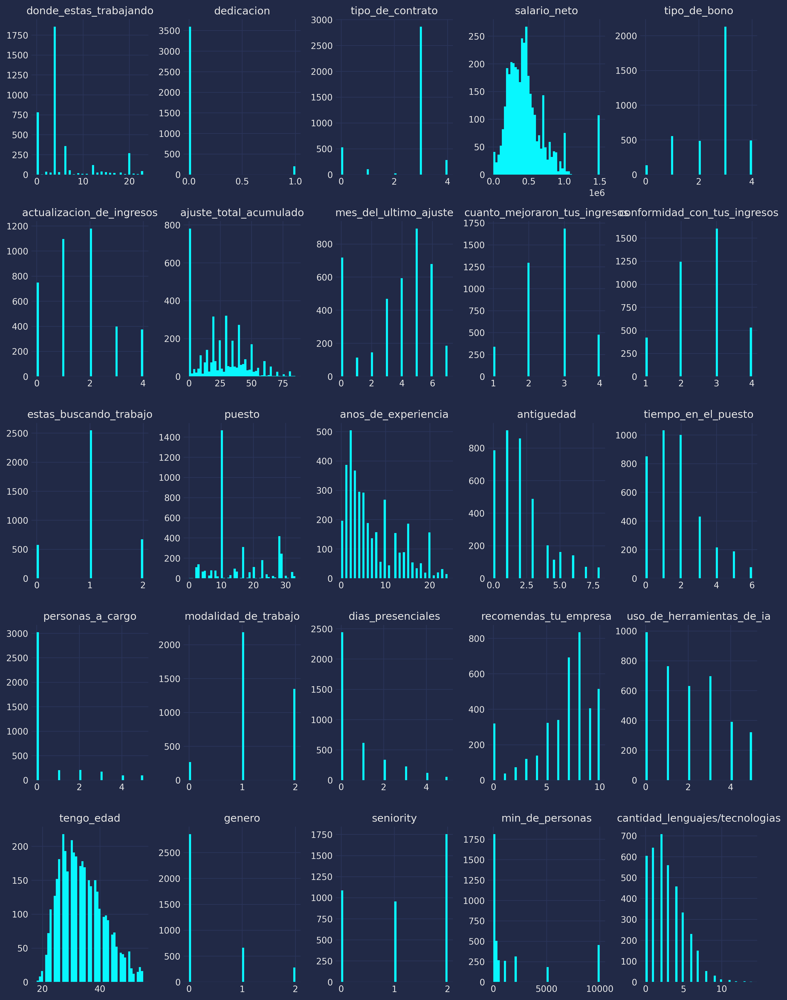

In [79]:
numerical_columns = train_clean.select_dtypes(["float64", "int64", "int32"]).columns

fig, ax = plt.subplots(5, 5, figsize=(15, 20), dpi=300)
train_clean[numerical_columns].hist(bins=50, ax=ax);

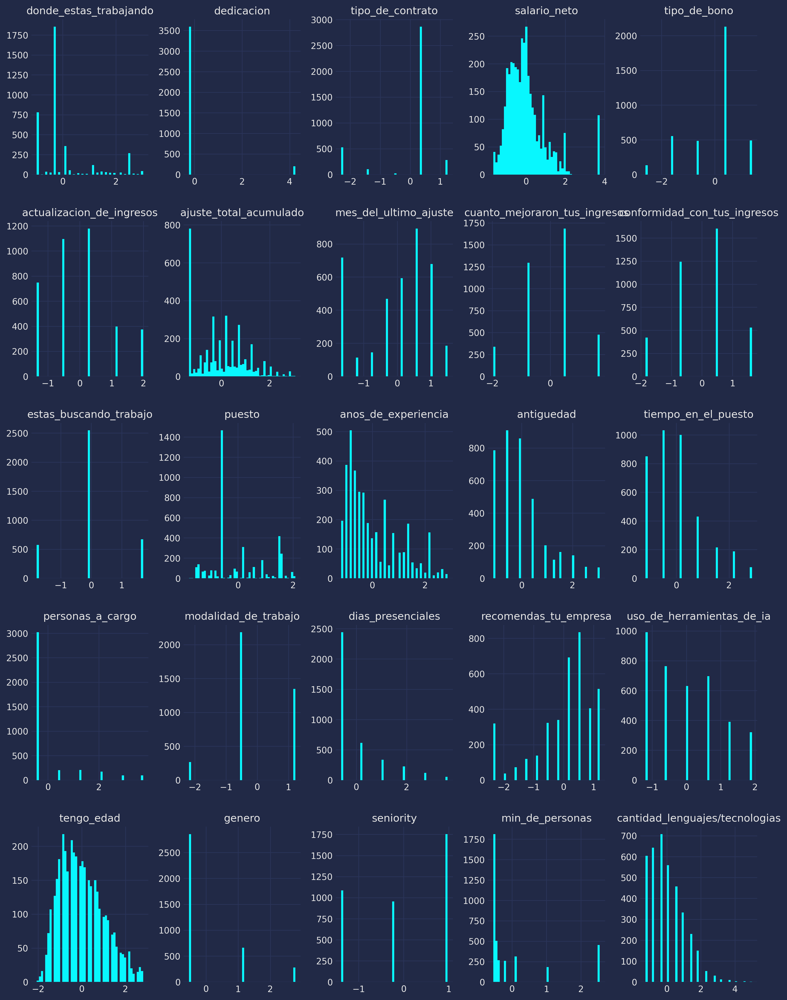

In [80]:
std = StandardScaler()
std.fit(train_clean[numerical_columns])

for dataset in [train_clean, test]:
    dataset[numerical_columns] = std.transform(dataset[numerical_columns])

fig, ax = plt.subplots(5, 5, figsize=(15, 20), dpi=300)
train_clean[numerical_columns].hist(bins=50, ax=ax);

# Preparando los sets por el tipo de tarea solicitada

## Regresion
### Target

In [81]:
y_train_rg = y_train["salario_bruto"]
y_test_rg = y_test["salario_bruto"]
y_train_rg.head()

579      349896.05
4192     320000.00
4554     137000.00
5195     375000.00
1685    2155000.00
Name: salario_bruto, dtype: float64

### Caracteristicas validas para la regresion

Debemos excluir todas aquellas caracteristicas que tengan una relacion directa con el salario bruto de los empleados. Y debemos incluir aquellas caracteristicas que para esta tarea no son consideradas target.

In [82]:
train_rg = pd.concat([train_clean, y_train.drop(["salario_bruto"], axis=1)], axis=1)
test_rg = pd.concat([test, y_test.drop(["salario_bruto"], axis=1)], axis=1)

train_rg.drop(["salario_neto"], axis=1, inplace=True)
test_rg.drop(["salario_neto"], axis=1, inplace=True)

train_rg.head()

,donde_estas_trabajando,dedicacion,tipo_de_contrato,tipo_de_bono,actualizacion_de_ingresos,ajuste_total_acumulado,mes_del_ultimo_ajuste,cuanto_mejoraron_tus_ingresos,conformidad_con_tus_ingresos,estas_buscando_trabajo,puesto,anos_de_experiencia,antiguedad,tiempo_en_el_puesto,personas_a_cargo,modalidad_de_trabajo,dias_presenciales,recomendas_tu_empresa,uso_de_herramientas_de_ia,tengo_edad,genero,sueldo_dolarizado,seniority,min_de_personas,recibe_Abono de Internet,recibe_Stock options / RSUs,recibe_Crédito en billeteras virtuales,recibe_Abono de celular,recibe_Comidas pagas / subvencionadas,recibe_Horarios flexibles,recibe_Capacitaciones y/o cursos,recibe_Licencia por nacimiento extendida,recibe_Vacaciones flexibles,recibe_Clases de idiomas,recibe_beneficios_gimnasia,recibe_Viáticos,otros_beneficios,usa_Mainframe,usa_Serverless,usa_Linux,usa_VMWare,usa_Google Cloud Platform,usa_OpenShift,usa_Salesforce,usa_Docker,usa_Firebase,usa_Amazon Web Services,usa_Windows Server,usa_Kubernetes,usa_Azure,usa_otros_plfs,usa_Hibernate,usa_Django,usa_Angular,usa_jQuery,usa_Rails,usa_React.js,usa_Laravel,usa_Spring,usa_Hadoop,usa_Bootstrap,usa_Flask,usa_Spark,usa_.NET Core,usa_Vue.js,usa_Next.js,usa_Node.js,usa_WordPress,usa_TensorFlow,usa_otros_frws,usa_SQLite,usa_MariaDB,usa_Microsoft SQL Server,usa_MySQL,usa_IBM Db2,usa_Amazon DynamoDB,usa_Teradata,usa_PostgreSQL,usa_CosmosDB,usa_HANA,usa_MongoDB,usa_Google Cloud Storage,usa_Oracle,usa_SQL,usa_Redis,usa_ElasticSearch,usa_Amazon RDS/Aurora,usa_otras_dbs,usa_Cucumber,usa_NUnit,usa_Cypress,usa_JUnit,usa_SoapUI,usa_Selenium,usa_Test Complete,usa_RSpec,usa_PHPUnit,usa_Visual Studio Coded UI,usa_Karma,usa_Xunit,usa_Mocha,usa_Postman,usa_Jest,usa_TFS,usa_otras_qa_tools,cantidad_lenguajes/tecnologias,Python,HTML,CSS,Java,C#,JavaScript,TypeScript,PHP,.NET,SQL,Bash/Shell,Otros
579,-0.979474,-0.235899,0.356543,0.396575,-0.517539,1.249224,-1.220732,0.482660,-0.685694,-0.044640,-0.607886,-0.678566,-0.068544,0.177647,-0.43863,-0.485078,3.626485,0.141681,0.049886,-0.219924,-0.531345,1,-0.207851,-0.231512,1,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.085765,0,1,1,1,0,1,0,0,0,0,0,0
4192,-0.283636,-0.235899,0.356543,0.396575,0.318011,0.214849,-0.314292,-1.965483,-1.846569,-0.044640,-1.426021,-0.678566,-1.115040,-1.167648,-0.43863,-0.485078,-0.604935,-0.924160,1.290983,-1.010440,-0.531345,0,-0.207851,-0.385672,1,0,0,0,0,1,0,0,1,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-0.360591,1,0,0,0,0,0,0,0,0,1,0,0
4554,0.064283,-0.235899,0.356543,0.396575,-0.517539,-0.302339,0.592149,0.482660,-0.685694,-0.044640,-0.607886,-1.014836,-0.591792,-0.495000,-0.43863,-2.190717,3.626485,0.496962,0.049886,-0.878687,-0.531345,0,-1.388372,-0.539524,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.424835,0,1,1,1,0,1,1,1,0,0,1,0
5195,-0.283636,-0.235899,0.356543,1.396311,-0.517539,-0.043745,1.498590,0.482660,1.636057,-1.790654,0.560877,-0.846701,-0.068544,0.177647,-0.43863,-0.485078,-0.604935,1.207523,-0.570663,-1.405698,1.123764,0,-1.388372,-0.524416,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1.253304,0,0,0,0,0,0,0,0,0,0,0,1
1685,-0.283636,-0.235899,0.356543,0.396575,-0.517539,-0.560932,-0.314292,0.482660,0.475182,-1.790654,-1.542897,2.179726,2.547698,0.177647,-0.43863,-0.485078,-0.604935,0.141681,-0.570663,1.624614,-0.531345,1,0.972670,0.076809,1,0,0,0,0,1,1,0,0,1,1,0,0,0,0,1,0,1,1,0,1,0,1,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,-0.806948,0,0,0,1,0,0,0,0,0,0,0,0


## Clasificacion
### Target

In [83]:
y_train_clf = y_train.drop(["salario_bruto"], axis=1)
y_test_clf = y_test.drop(["salario_bruto"], axis=1)
y_train_clf.head()

,Python,HTML,CSS,Java,C#,JavaScript,TypeScript,PHP,.NET,SQL,Bash/Shell,Otros
579,0,1,1,1,0,1,0,0,0,0,0,0
4192,1,0,0,0,0,0,0,0,0,1,0,0
4554,0,1,1,1,0,1,1,1,0,0,1,0
5195,0,0,0,0,0,0,0,0,0,0,0,1
1685,0,0,0,1,0,0,0,0,0,0,0,0


### Caracteristicas validas para la clasificacion

Debemos excluir todas aquellas caracteristicas que tengan una relacion directa con los lenguajes y tecnologias que usan los empleados. Y debemos incluir aquellas caracteristicas que para esta tarea no son consideradas target.

In [84]:
train_clf = pd.concat([train_clean, y_train[["salario_bruto"]]], axis=1)
test_clf = pd.concat([test, y_test[["salario_bruto"]]], axis=1)

train_clf.drop(["cantidad_lenguajes/tecnologias"], axis=1, inplace=True)
test_clf.drop(["cantidad_lenguajes/tecnologias"], axis=1, inplace=True)

train_clf.head()

,donde_estas_trabajando,dedicacion,tipo_de_contrato,salario_neto,tipo_de_bono,actualizacion_de_ingresos,ajuste_total_acumulado,mes_del_ultimo_ajuste,cuanto_mejoraron_tus_ingresos,conformidad_con_tus_ingresos,estas_buscando_trabajo,puesto,anos_de_experiencia,antiguedad,tiempo_en_el_puesto,personas_a_cargo,modalidad_de_trabajo,dias_presenciales,recomendas_tu_empresa,uso_de_herramientas_de_ia,tengo_edad,genero,sueldo_dolarizado,seniority,min_de_personas,recibe_Abono de Internet,recibe_Stock options / RSUs,recibe_Crédito en billeteras virtuales,recibe_Abono de celular,recibe_Comidas pagas / subvencionadas,recibe_Horarios flexibles,recibe_Capacitaciones y/o cursos,recibe_Licencia por nacimiento extendida,recibe_Vacaciones flexibles,recibe_Clases de idiomas,recibe_beneficios_gimnasia,recibe_Viáticos,otros_beneficios,usa_Mainframe,usa_Serverless,usa_Linux,usa_VMWare,usa_Google Cloud Platform,usa_OpenShift,usa_Salesforce,usa_Docker,usa_Firebase,usa_Amazon Web Services,usa_Windows Server,usa_Kubernetes,usa_Azure,usa_otros_plfs,usa_Hibernate,usa_Django,usa_Angular,usa_jQuery,usa_Rails,usa_React.js,usa_Laravel,usa_Spring,usa_Hadoop,usa_Bootstrap,usa_Flask,usa_Spark,usa_.NET Core,usa_Vue.js,usa_Next.js,usa_Node.js,usa_WordPress,usa_TensorFlow,usa_otros_frws,usa_SQLite,usa_MariaDB,usa_Microsoft SQL Server,usa_MySQL,usa_IBM Db2,usa_Amazon DynamoDB,usa_Teradata,usa_PostgreSQL,usa_CosmosDB,usa_HANA,usa_MongoDB,usa_Google Cloud Storage,usa_Oracle,usa_SQL,usa_Redis,usa_ElasticSearch,usa_Amazon RDS/Aurora,usa_otras_dbs,usa_Cucumber,usa_NUnit,usa_Cypress,usa_JUnit,usa_SoapUI,usa_Selenium,usa_Test Complete,usa_RSpec,usa_PHPUnit,usa_Visual Studio Coded UI,usa_Karma,usa_Xunit,usa_Mocha,usa_Postman,usa_Jest,usa_TFS,usa_otras_qa_tools,salario_bruto
579,-0.979474,-0.235899,0.356543,-0.617838,0.396575,-0.517539,1.249224,-1.220732,0.482660,-0.685694,-0.044640,-0.607886,-0.678566,-0.068544,0.177647,-0.43863,-0.485078,3.626485,0.141681,0.049886,-0.219924,-0.531345,1,-0.207851,-0.231512,1,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,349896.05
4192,-0.283636,-0.235899,0.356543,-0.691553,0.396575,0.318011,0.214849,-0.314292,-1.965483,-1.846569,-0.044640,-1.426021,-0.678566,-1.115040,-1.167648,-0.43863,-0.485078,-0.604935,-0.924160,1.290983,-1.010440,-0.531345,0,-0.207851,-0.385672,1,0,0,0,0,1,0,0,1,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,320000.00
4554,0.064283,-0.235899,0.356543,-1.171813,0.396575,-0.517539,-0.302339,0.592149,0.482660,-0.685694,-0.044640,-0.607886,-1.014836,-0.591792,-0.495000,-0.43863,-2.190717,3.626485,0.496962,0.049886,-0.878687,-0.531345,0,-1.388372,-0.539524,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,137000.00
5195,-0.283636,-0.235899,0.356543,-0.554336,1.396311,-0.517539,-0.043745,1.498590,0.482660,1.636057,-1.790654,0.560877,-0.846701,-0.068544,0.177647,-0.43863,-0.485078,-0.604935,1.207523,-0.570663,-1.405698,1.123764,0,-1.388372,-0.524416,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,375000.00
1685,-0.283636,-0.235899,0.356543,0.861168,0.396575,-0.517539,-0.560932,-0.314292,0.482660,0.475182,-1.790654,-1.542897,2.179726,2.547698,0.177647,-0.43863,-0.485078,-0.604935,0.141681,-0.570663,1.624614,-0.531345,1,0.972670,0.076809,1,0,0,0,0,1,1,0,0,1,1,0,0,0,0,1,0,1,1,0,1,0,1,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2155000.00


# Feature Selection
## Regresion

In [85]:
fs_rg = SelectKBest(score_func=f_regression, k=30)
X_train_rg = fs_rg.fit_transform(train_rg, y_train_rg)
X_test_rg = fs_rg.transform(test_rg)
train_rg.shape, X_train_rg.shape

((3794, 118), (3794, 30))

### Caracteristicas mas importantes

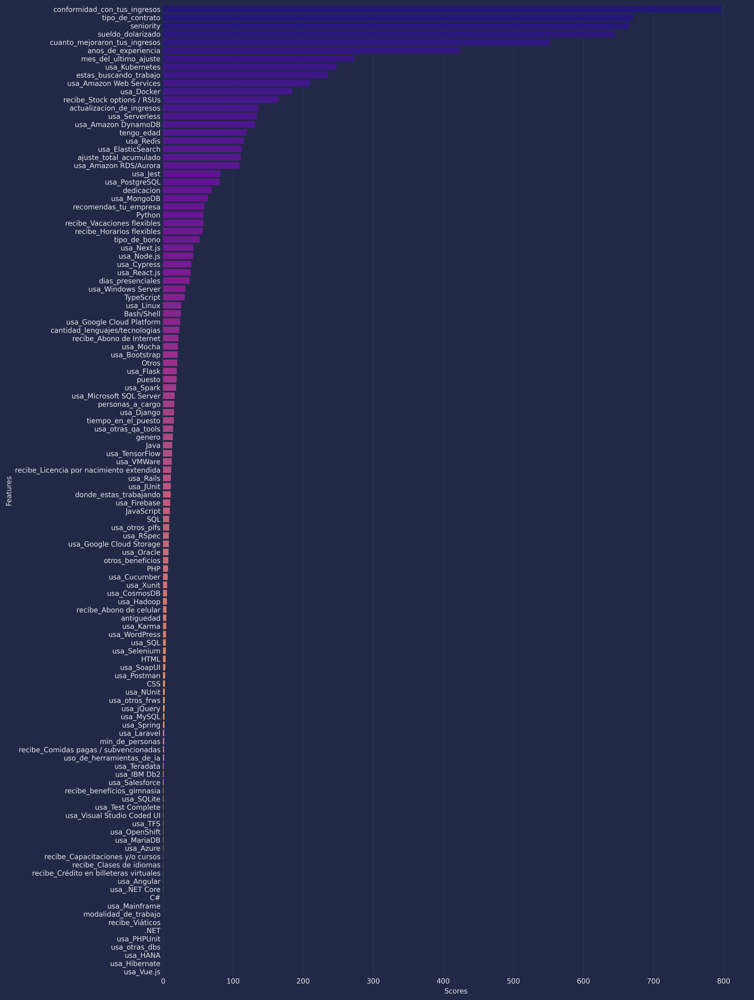

In [86]:
plt.figure(figsize=(15, 25), dpi=300)
feature_scores = pd.DataFrame({"Features":fs_rg.feature_names_in_, "Scores":fs_rg.scores_})
sns.barplot(data=feature_scores, x="Scores", y="Features", palette="plasma", order=feature_scores.sort_values(by="Scores", ascending=False)["Features"]);

## Clasificacion

In [87]:
from sklearn.feature_selection import f_classif

selected_features = [] 
for y_col in y_train_clf.columns:
    fs_clf = SelectKBest(f_classif, k='all')
    fs_clf.fit(train_clf, y_train_clf[y_col])
    selected_features.append(list(fs_clf.scores_))


selected_features = np.mean(selected_features, axis=0)

### Caracteristicas mas importantes

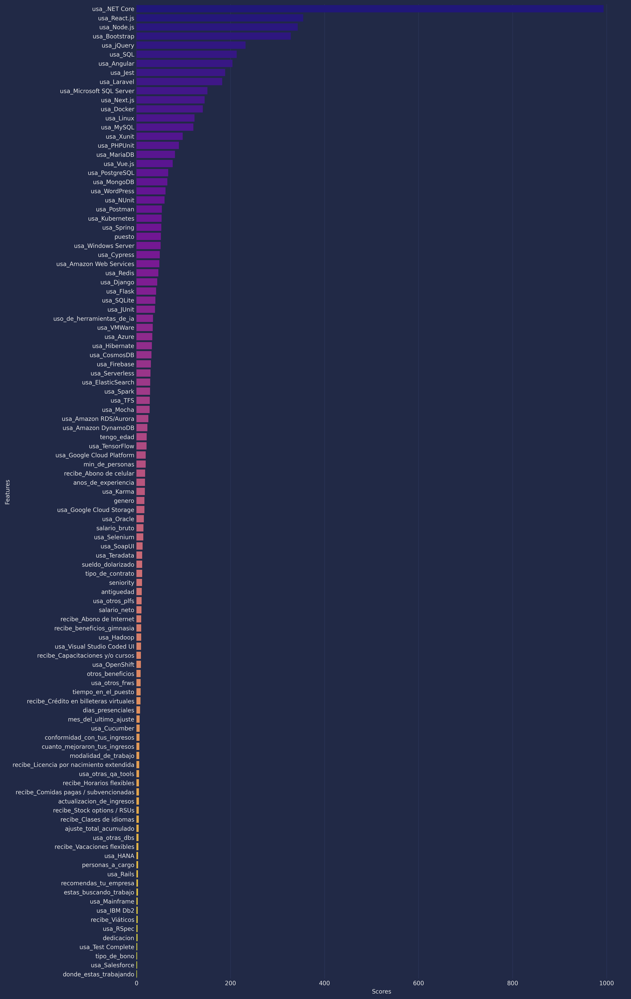

In [88]:
plt.figure(figsize=(15, 30), dpi=300)
feature_scores = pd.DataFrame({"Features":fs_clf.feature_names_in_, "Scores":selected_features})
sns.barplot(data=feature_scores, x="Scores", y="Features", palette="plasma", order=feature_scores.sort_values(by="Scores", ascending=False)["Features"]);

In [89]:
most_important_features = feature_scores.sort_values(by="Scores", ascending=False)["Features"][:30].values
X_train_clf = train_clf[most_important_features].copy()
X_test_clf = test_clf[most_important_features].copy()

# Entrenando estimadores y clasificadores

## Regresion

### Linear Regressor

In [90]:
def metrics(X, y, model=None):
    y_pred = model.predict(X)
    print(f"R2: {r2_score(y, y_pred)}")
    print(f"MSE: {mean_squared_error(y, y_pred)}")
    print(f"MAE: {mean_absolute_error(y, y_pred)}")
    return

lr = LinearRegression()
lr.fit(X_train_rg, y_train_rg)
metrics(X_test_rg, y_test_rg, lr)

R2: 0.49308206882989003
MSE: 196343124208.66806
MAE: 296909.31532917044


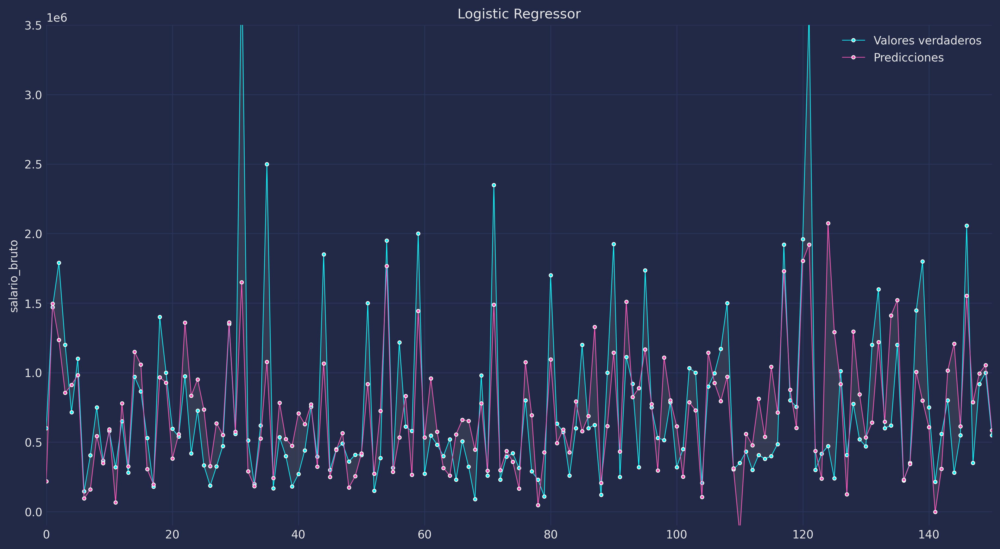

In [91]:
def plot_compare_prediction(X_test, y_test, model=None, title=""):
    fig, ax = plt.subplots(figsize=(15, 8), dpi=300)
    y_test_pred = model.predict(X_test)
    sns.lineplot(y=y_test, x=np.arange(0, len(y_test)), linewidth=0.6, ax=ax, marker="o", markersize=3, legend='brief', label="Valores verdaderos")
    sns.lineplot(y=y_test_pred, x=np.arange(0, len(y_test)), linewidth=0.6, ax=ax, marker="o", markersize=3, legend='brief', label="Predicciones")
    plt.fill_between(np.arange(0, len(y_test)), y_test, y_test_pred, color="gray", alpha=0.2)
    ax.set_xlim(0, 150)
    ax.set_ylim(-0.1e6, 3.5e6)
    ax.set_title(title)
    return

plot_compare_prediction(X_test_rg, y_test_rg, lr, "Logistic Regressor")

Algunas predicciones arrojan valores negativos de salario, claramente este modelo no es el mejor.

### Stochastic Gradient Descent Regressor:

In [92]:
param = {
    "alpha": np.linspace(0.0005, 0.005, 5),
    "max_iter": np.linspace(1500, 3000, 3, dtype=int),
    "learning_rate": ["optimal", "adaptive"],
    "eta0": np.linspace(0.01, 0.1, 10)
}

sgd = GridSearchCV(SGDRegressor(random_state=seed_value), param_grid=param, cv=5, n_jobs=-1, verbose=1)
sgd.fit(X_train_rg, y_train_rg)

Fitting 5 folds for each of 300 candidates, totalling 1500 fits


GridSearchCV(cv=5, estimator=SGDRegressor(random_state=42), n_jobs=-1,
             param_grid={'alpha': array([0.0005  , 0.001625, 0.00275 , 0.003875, 0.005   ]),
                         'eta0': array([0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ]),
                         'learning_rate': ['optimal', 'adaptive'],
                         'max_iter': array([1500, 2250, 3000])},
             verbose=1)

In [93]:
sgd.best_params_

{'alpha': 0.005,
 'eta0': 0.09000000000000001,
 'learning_rate': 'adaptive',
 'max_iter': 1500}

In [94]:
metrics(X_test_rg, y_test_rg, sgd)

R2: 0.49323195930253916
MSE: 196285067545.29236
MAE: 296538.6575101456


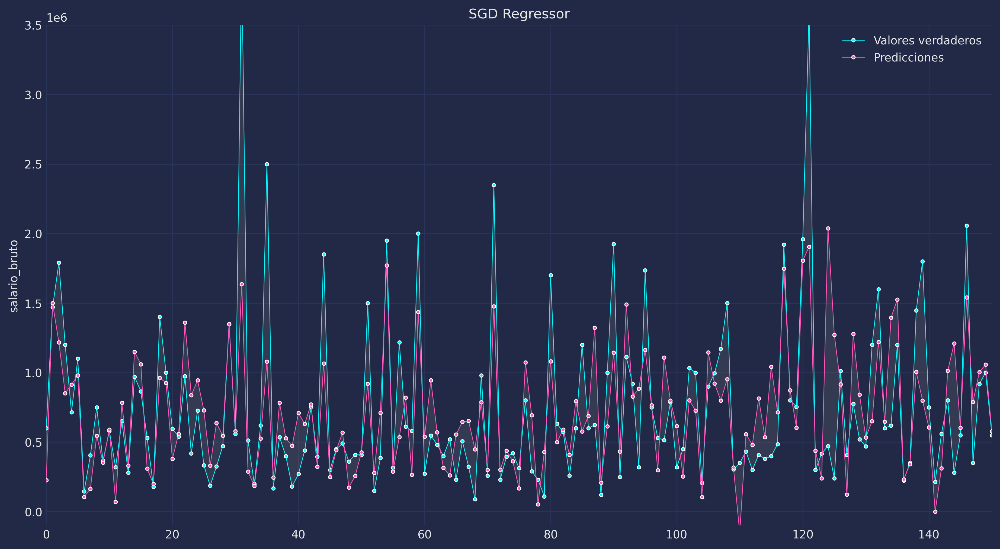

In [95]:
plot_compare_prediction(X_test_rg, y_test_rg, sgd, "SGD Regressor")

Algunas predicciones arrojan valores negativos de salario, claramente este modelo tampoco es el mejor.

### Random Forest Regressor

In [96]:
param = {
    "criterion": ["absolute_error"],
    "n_estimators": [10],
    "max_depth": [18],
}

rf = RandomForestRegressor(criterion="absolute_error", n_estimators=800, random_state=seed_value, n_jobs=-1)
rf.fit(X_train_rg, y_train_rg)

RandomForestRegressor(criterion='absolute_error', n_estimators=800, n_jobs=-1,
                      random_state=42)

In [97]:
metrics(X_test_rg, y_test_rg, rf)

R2: 0.5861706914667439
MSE: 160287364739.65015
MAE: 246487.3520981934


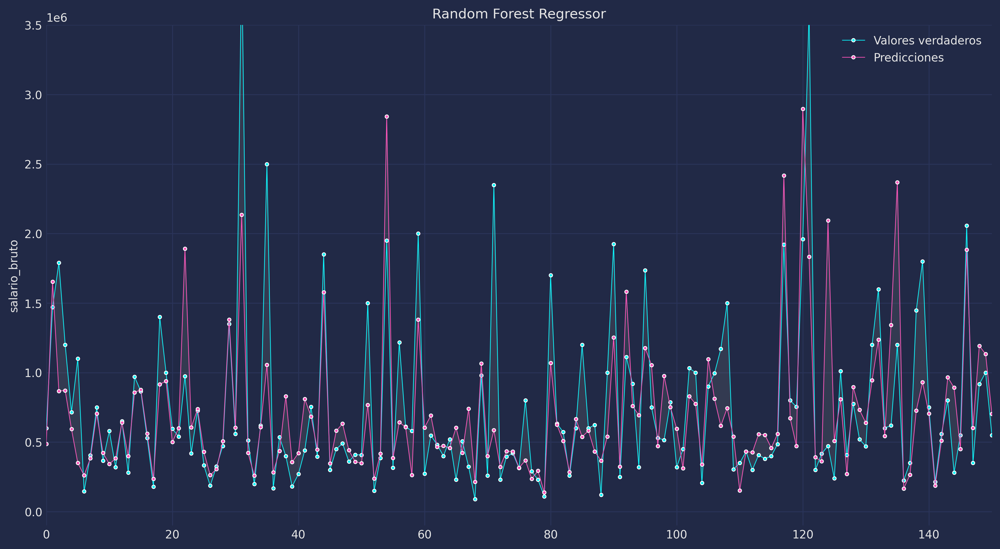

In [98]:
plot_compare_prediction(X_test_rg, y_test_rg, rf, "Random Forest Regressor")

### AdaBoost Regressor

In [99]:
param = {
    "n_estimators": np.linspace(1500, 2000, 3, dtype=int),
    "learning_rate": np.linspace(0.001, 0.01, 5),
    "loss": ["linear", "exponential"]
}

ada = GridSearchCV(AdaBoostRegressor(random_state=seed_value), param_grid=param, n_jobs=-1, cv=5, verbose=1)
ada.fit(X_train_rg, y_train_rg)

Fitting 5 folds for each of 30 candidates, totalling 150 fits


GridSearchCV(cv=5, estimator=AdaBoostRegressor(random_state=42), n_jobs=-1,
             param_grid={'learning_rate': array([0.001  , 0.00325, 0.0055 , 0.00775, 0.01   ]),
                         'loss': ['linear', 'exponential'],
                         'n_estimators': array([1500, 1750, 2000])},
             verbose=1)

In [100]:
ada.best_params_

{'learning_rate': 0.0032500000000000003,
 'loss': 'linear',
 'n_estimators': 1500}

In [101]:
metrics(X_test_rg, y_test_rg, ada)

R2: 0.5423980434275189
MSE: 177241703780.42834
MAE: 281625.2442355866


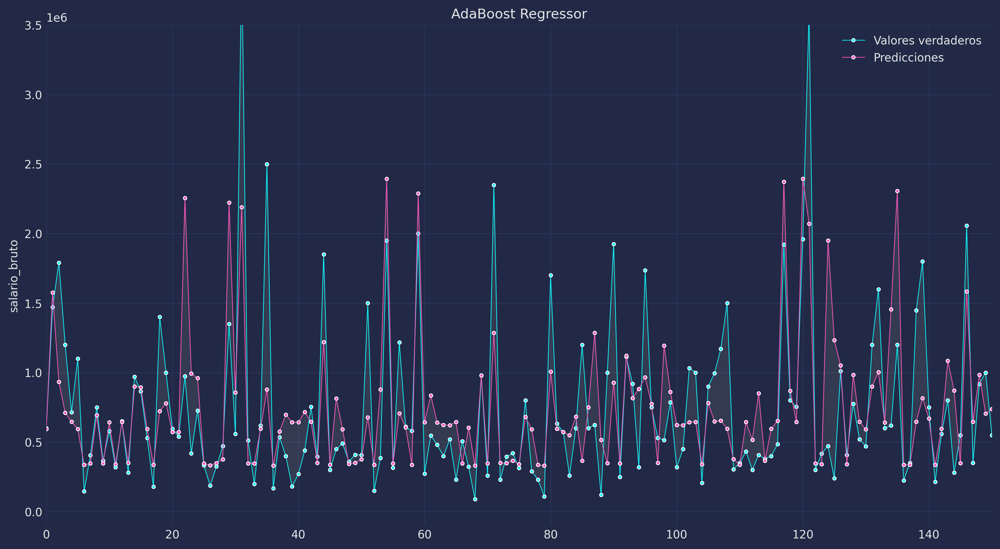

In [102]:
plot_compare_prediction(X_test_rg, y_test_rg, ada, "AdaBoost Regressor")

## Clasificacion

### Logistic Regressor con MultiOutput Classifier

In [103]:
from sklearn.linear_model import LogisticRegression
from sklearn.multioutput import MultiOutputClassifier

lr_clf = MultiOutputClassifier(LogisticRegression(random_state=seed_value))

param_grid = {"estimator__max_iter": [200, 250],
             "estimator__C": np.linspace(1, 10, 10),
             "estimator__tol":np.linspace(5e-1, 1.5, 5)}

lr_clf = GridSearchCV(lr_clf, param_grid, cv=5)
lr_clf.fit(X_train_clf, y_train_clf)

GridSearchCV(cv=5,
             estimator=MultiOutputClassifier(estimator=LogisticRegression(random_state=42)),
             param_grid={'estimator__C': array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.]),
                         'estimator__max_iter': [200, 250],
                         'estimator__tol': array([0.5 , 0.75, 1.  , 1.25, 1.5 ])})

In [104]:
lr_clf.best_params_

{'estimator__C': 7.0, 'estimator__max_iter': 200, 'estimator__tol': 1.0}

In [105]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

def my_cm(y_test, y_pred):
    fig, axs = plt.subplots(4, 3, figsize=(15, 15))
    for i, col in enumerate(y_test.columns):
        plt.subplot(4, 3, i+1)
        cm_val = confusion_matrix(y_test[col], y_pred[col])
        cm_pgs = np.round(confusion_matrix(y_test[col], y_pred[col], normalize='true')*100, 4)

        formatted_text = (np.asarray([f"{pgs}%\n({val})" for val, pgs in zip(cm_val.flatten(), cm_pgs.flatten())])).reshape(2, 2)

        sns.heatmap(cm_pgs, annot=formatted_text, fmt='', cmap='BuPu')
        plt.title(col)
        plt.xlabel("Prediction")
        plt.ylabel("Actual")
        
    plt.subplots_adjust(hspace=0.5)
    return

def predictions2df(y_pred):
    return pd.DataFrame({"Python":y_pred[:, 0],
                  "HTML":y_pred[:, 1],
                  "CSS":y_pred[:, 2],
                  "Java":y_pred[:, 3],
                  "C#":y_pred[:, 4],
                  "JavaScript":y_pred[:, 5],
                  "TypeScript":y_pred[:, 6],
                  "PHP":y_pred[:, 7],
                  ".NET":y_pred[:, 8],
                  "SQL":y_pred[:, 9],
                  "Bash/Shell":y_pred[:, 10],
                  "Otros":y_pred[:, 11]
                 })

y_pred_lr_clf = predictions2df(lr_clf.predict(X_test_clf))
pd.DataFrame(data=classification_report(y_test_clf, y_pred_lr_clf, target_names=y_test_clf.columns, digits=6, output_dict=True, zero_division=0)).transpose()

,precision,recall,f1-score,support
Python,0.696721,0.181237,0.287648,469.0
HTML,0.789137,0.545254,0.644909,453.0
CSS,0.666667,0.271523,0.385882,302.0
Java,0.921136,0.729089,0.813937,801.0
C#,0.869159,0.574074,0.691450,162.0
JavaScript,0.882845,0.670906,0.762421,629.0
TypeScript,0.743902,0.445255,0.557078,274.0
PHP,0.753521,0.578378,0.654434,185.0
.NET,0.914110,0.805405,0.856322,185.0
SQL,0.714286,0.386861,0.501894,685.0


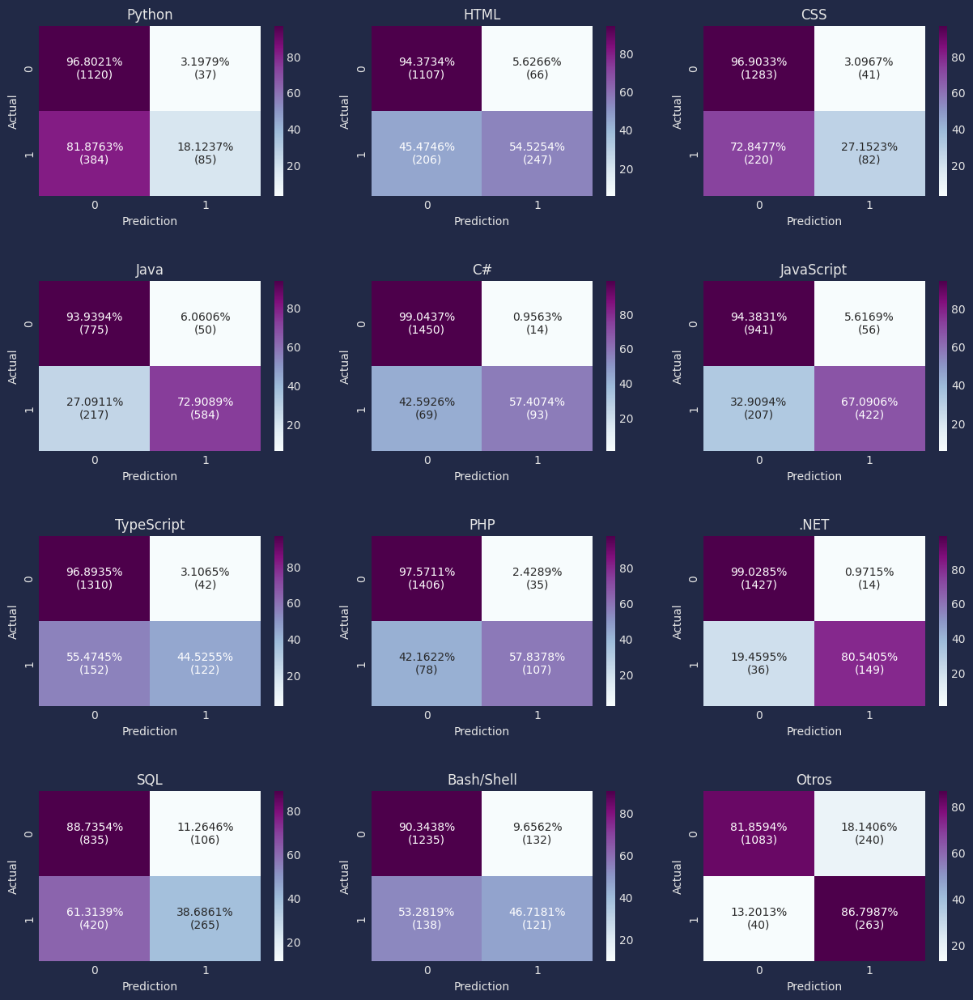

In [106]:
my_cm(y_test_clf, y_pred_lr_clf)

### Random Forest Classifier

In [107]:
from sklearn.ensemble import RandomForestClassifier

#lr_clf = MultiOutputClassifier(LogisticRegression(random_state=seed_value))

param_grid = {"n_estimators": [400, 500, 600],
             "max_depth": np.linspace(30, 50, 10, dtype=int)}

rf_clf = GridSearchCV(RandomForestClassifier(), param_grid, cv=5)
rf_clf.fit(X_train_clf, y_train_clf)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'max_depth': array([30, 32, 34, 36, 38, 41, 43, 45, 47, 50]),
                         'n_estimators': [400, 500, 600]})

In [108]:
rf_clf.best_params_

{'max_depth': 41, 'n_estimators': 500}

In [109]:
y_pred_rf_clf = predictions2df(rf_clf.predict(X_test_clf))
pd.DataFrame(data=classification_report(y_test_clf, y_pred_rf_clf, target_names=y_test_clf.columns, digits=6, output_dict=True, zero_division=0)).transpose()

,precision,recall,f1-score,support
Python,0.540323,0.285714,0.373780,469.0
HTML,0.718750,0.558499,0.628571,453.0
CSS,0.578947,0.327815,0.418605,302.0
Java,0.847278,0.796504,0.821107,801.0
C#,0.763780,0.598765,0.671280,162.0
JavaScript,0.826377,0.786963,0.806189,629.0
TypeScript,0.706522,0.474453,0.567686,274.0
PHP,0.871795,0.367568,0.517110,185.0
.NET,0.855422,0.767568,0.809117,185.0
SQL,0.600000,0.600000,0.600000,685.0


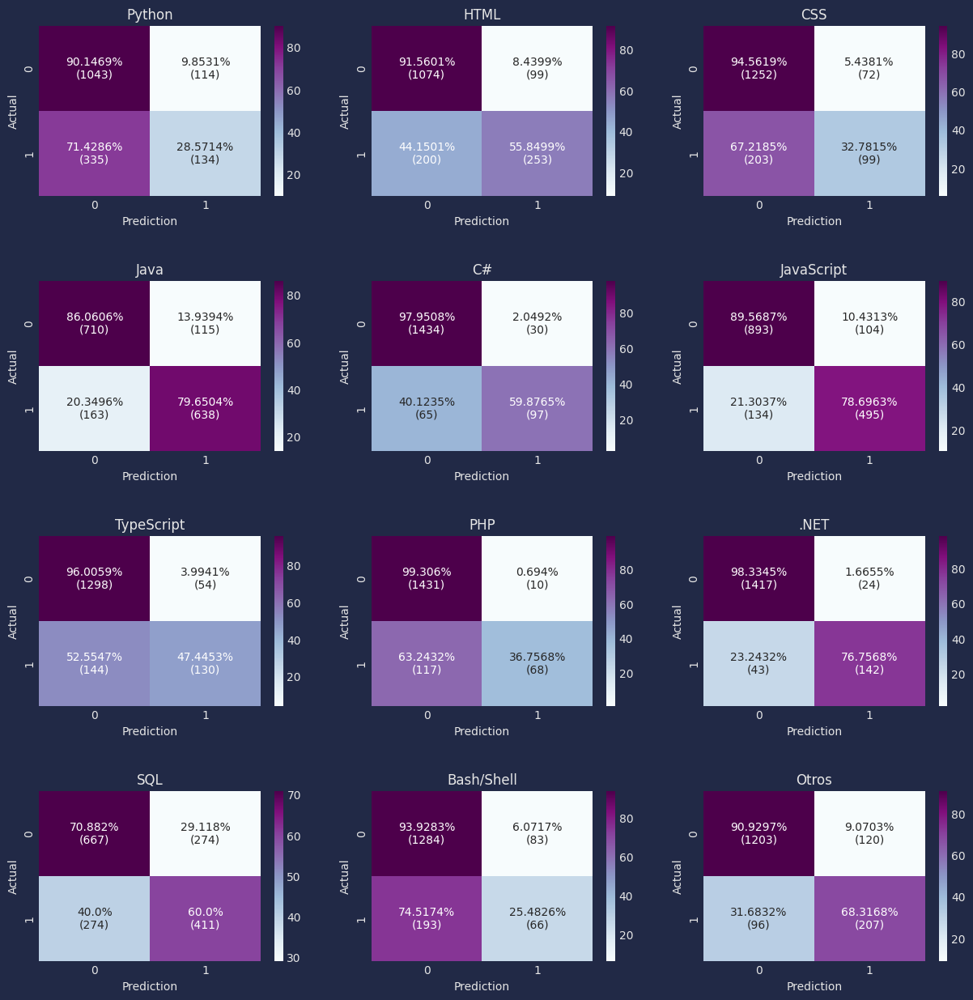

In [110]:
my_cm(y_test_clf, y_pred_rf_clf)